In [2]:
import torch
import torch.nn as nn
import torchvision.transforms as transforms
import torch.optim as optim
import torchvision.datasets as datasets
import imageio
import numpy as np
import matplotlib
from torchvision.utils import make_grid, save_image
from torch.utils.data import DataLoader
from matplotlib import pyplot as plt
from tqdm import tqdm

# Define learning parameters

In [46]:
# learning parameters
batch_size = 512
epochs = 100
sample_size = 64 # fixed sample size for generator
nz = 128 # latent vector size
k = 1 # number of steps to apply to the discriminator
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

device(type='cpu')

# Prepare training dataset

In [4]:
transform = transforms.Compose([
                                transforms.ToTensor(),
                                transforms.Normalize((0.5,),(0.5,)),
])
to_pil_image = transforms.ToPILImage()

# Make input, output folders
!mkdir -p input
!mkdir -p outputs

# Load train data
train_data = datasets.MNIST(
    root='input/data',
    train=True,
    download=True,
    transform=transform
)
train_loader = DataLoader(train_data, batch_size=batch_size, shuffle=True)

# Generator

In [5]:
class Generator(nn.Module):
    def __init__(self, nz):
        super(Generator, self).__init__()
        self.nz = nz
        self.main = nn.Sequential(
            nn.Linear(self.nz, 256),
            nn.LeakyReLU(0.2),
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2),
            nn.Linear(512, 1024),
            nn.LeakyReLU(0.2),
            nn.Linear(1024, 784),
            nn.Tanh(),
        )
    def forward(self, x):
        return self.main(x).view(-1, 1, 28, 28)

# Discriminator

In [6]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.n_input = 784
        self.main = nn.Sequential(
            nn.Linear(self.n_input, 1024),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3),
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3),
            nn.Linear(256, 1),
            nn.Sigmoid(),
        )
    def forward(self, x):
        x = x.view(-1, 784)
        return self.main(x)

In [7]:
generator = Generator(nz).to(device)
discriminator = Discriminator().to(device)
print('##### GENERATOR #####')
print(generator)
print('######################')
print('\n##### DISCRIMINATOR #####')
print(discriminator)
print('######################')

##### GENERATOR #####
Generator(
  (main): Sequential(
    (0): Linear(in_features=128, out_features=256, bias=True)
    (1): LeakyReLU(negative_slope=0.2)
    (2): Linear(in_features=256, out_features=512, bias=True)
    (3): LeakyReLU(negative_slope=0.2)
    (4): Linear(in_features=512, out_features=1024, bias=True)
    (5): LeakyReLU(negative_slope=0.2)
    (6): Linear(in_features=1024, out_features=784, bias=True)
    (7): Tanh()
  )
)
######################

##### DISCRIMINATOR #####
Discriminator(
  (main): Sequential(
    (0): Linear(in_features=784, out_features=1024, bias=True)
    (1): LeakyReLU(negative_slope=0.2)
    (2): Dropout(p=0.3, inplace=False)
    (3): Linear(in_features=1024, out_features=512, bias=True)
    (4): LeakyReLU(negative_slope=0.2)
    (5): Dropout(p=0.3, inplace=False)
    (6): Linear(in_features=512, out_features=256, bias=True)
    (7): LeakyReLU(negative_slope=0.2)
    (8): Dropout(p=0.3, inplace=False)
    (9): Linear(in_features=256, out_features=1

# Tools for training

In [8]:
# optimizers
optim_g = optim.Adam(generator.parameters(), lr=0.0002)
optim_d = optim.Adam(discriminator.parameters(), lr=0.0002)

In [9]:
# loss function
criterion = nn.BCELoss() # Binary Cross Entropy loss

In [10]:
losses_g = [] # to store generator loss after each epoch
losses_d = [] # to store discriminator loss after each epoch
images = [] # to store images generatd by the generator

In [11]:
# to create real labels (1s)
def label_real(size):
    data = torch.ones(size)
    return data.to(device)
# to create fake labels (0s)
def label_fake(size):
    data = torch.zeros(size)
    return data.to(device)


In [12]:
# function to create the noise vector
def create_noise(sample_size, nz):
    return torch.randn(sample_size, nz).to(device)

In [13]:
# to save the images generated by the generator
def save_generator_image(image, path):
    save_image(image, path)

In [14]:
# create the noise vector - fixed to track how GAN is trained.
noise = create_noise(sample_size, nz)

# Q. Write training loop

118it [00:08, 13.54it/s]                         


Epoch 1 of 200
Generator loss: 0.02326271, Discriminator loss: 0.00476702


118it [00:08, 13.70it/s]                         


Epoch 2 of 200
Generator loss: 0.01170835, Discriminator loss: 0.00805430


118it [00:08, 13.64it/s]                         


Epoch 3 of 200
Generator loss: 0.03629613, Discriminator loss: 0.00173821


118it [00:08, 13.55it/s]                         


Epoch 4 of 200
Generator loss: 0.01871630, Discriminator loss: 0.00909616


118it [00:08, 13.49it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


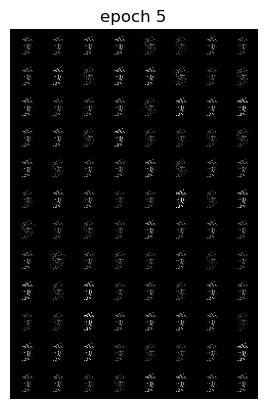

Epoch 5 of 200
Generator loss: 0.02242157, Discriminator loss: 0.00412595


118it [00:08, 13.50it/s]                         


Epoch 6 of 200
Generator loss: 0.02945100, Discriminator loss: 0.00861434


118it [00:08, 13.59it/s]                         


Epoch 7 of 200
Generator loss: 0.03149530, Discriminator loss: 0.00188725


118it [00:08, 13.72it/s]                         


Epoch 8 of 200
Generator loss: 0.02013809, Discriminator loss: 0.00910475


118it [00:08, 13.74it/s]                         


Epoch 9 of 200
Generator loss: 0.01142273, Discriminator loss: 0.00737749


118it [00:08, 13.66it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


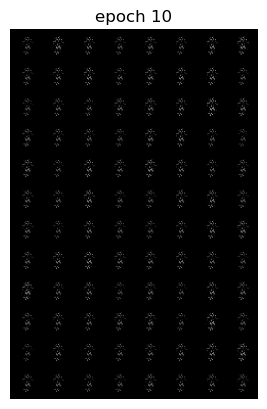

Epoch 10 of 200
Generator loss: 0.02209291, Discriminator loss: 0.00786229


118it [00:08, 13.81it/s]                         


Epoch 11 of 200
Generator loss: 0.01362763, Discriminator loss: 0.00723147


118it [00:08, 13.82it/s]                         


Epoch 12 of 200
Generator loss: 0.01352380, Discriminator loss: 0.00544401


118it [00:08, 13.92it/s]                         


Epoch 13 of 200
Generator loss: 0.01311203, Discriminator loss: 0.00597535


118it [00:08, 13.90it/s]                         


Epoch 14 of 200
Generator loss: 0.00752870, Discriminator loss: 0.01151679


118it [00:08, 14.02it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


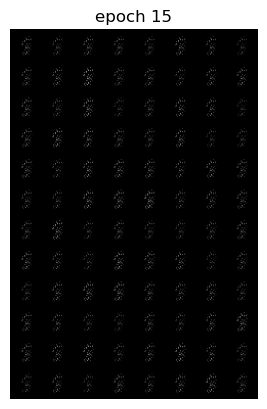

Epoch 15 of 200
Generator loss: 0.00971070, Discriminator loss: 0.01020005


118it [00:08, 13.89it/s]                         


Epoch 16 of 200
Generator loss: 0.01718908, Discriminator loss: 0.00535482


118it [00:08, 14.06it/s]                         


Epoch 17 of 200
Generator loss: 0.01427207, Discriminator loss: 0.00524143


118it [00:08, 14.02it/s]                         


Epoch 18 of 200
Generator loss: 0.01162954, Discriminator loss: 0.01079496


118it [00:08, 14.06it/s]                         


Epoch 19 of 200
Generator loss: 0.00914561, Discriminator loss: 0.00996918


118it [00:08, 14.09it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


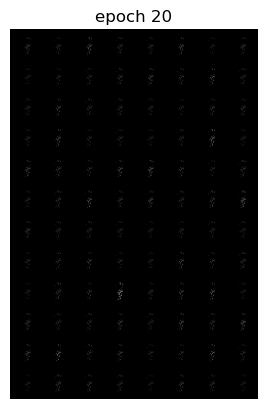

Epoch 20 of 200
Generator loss: 0.02065570, Discriminator loss: 0.00309740


118it [00:08, 13.97it/s]                         


Epoch 21 of 200
Generator loss: 0.00773177, Discriminator loss: 0.01075503


118it [00:08, 13.96it/s]                         


Epoch 22 of 200
Generator loss: 0.01390244, Discriminator loss: 0.01028472


118it [00:08, 14.09it/s]                         


Epoch 23 of 200
Generator loss: 0.02292822, Discriminator loss: 0.00230633


118it [00:08, 14.03it/s]                         


Epoch 24 of 200
Generator loss: 0.02079041, Discriminator loss: 0.00382015


118it [00:08, 14.03it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


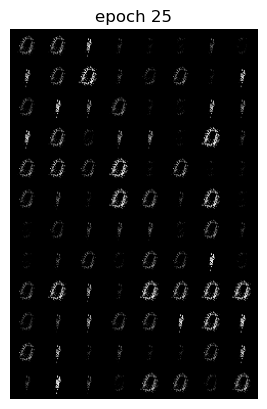

Epoch 25 of 200
Generator loss: 0.02798589, Discriminator loss: 0.00279083


118it [00:08, 14.04it/s]                         


Epoch 26 of 200
Generator loss: 0.04085312, Discriminator loss: 0.00466721


118it [00:08, 14.00it/s]                         


Epoch 27 of 200
Generator loss: 0.02531702, Discriminator loss: 0.00383007


118it [00:08, 14.28it/s]                         


Epoch 28 of 200
Generator loss: 0.02117447, Discriminator loss: 0.00467066


118it [00:08, 14.37it/s]                         


Epoch 29 of 200
Generator loss: 0.02087035, Discriminator loss: 0.00600353


118it [00:08, 14.57it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


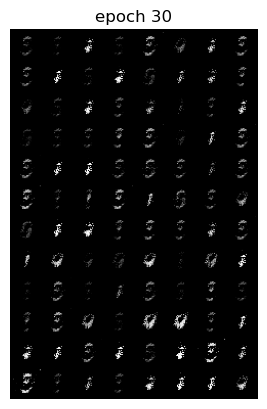

Epoch 30 of 200
Generator loss: 0.02452974, Discriminator loss: 0.00526193


118it [00:08, 14.45it/s]                         


Epoch 31 of 200
Generator loss: 0.02609000, Discriminator loss: 0.00521505


118it [00:08, 14.45it/s]                         


Epoch 32 of 200
Generator loss: 0.03100932, Discriminator loss: 0.00580035


118it [00:08, 14.11it/s]                         


Epoch 33 of 200
Generator loss: 0.01469758, Discriminator loss: 0.00762324


118it [00:08, 14.09it/s]                         


Epoch 34 of 200
Generator loss: 0.02137101, Discriminator loss: 0.00578995


118it [00:08, 14.35it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


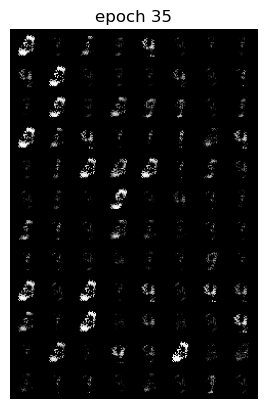

Epoch 35 of 200
Generator loss: 0.01572587, Discriminator loss: 0.00675896


118it [00:08, 14.56it/s]                         


Epoch 36 of 200
Generator loss: 0.02468522, Discriminator loss: 0.00286273


118it [00:08, 13.53it/s]                         


Epoch 37 of 200
Generator loss: 0.02402034, Discriminator loss: 0.00606884


118it [00:08, 14.40it/s]                         


Epoch 38 of 200
Generator loss: 0.03940790, Discriminator loss: 0.00424363


118it [00:08, 14.48it/s]                         


Epoch 39 of 200
Generator loss: 0.03118654, Discriminator loss: 0.00281581


118it [00:08, 14.48it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


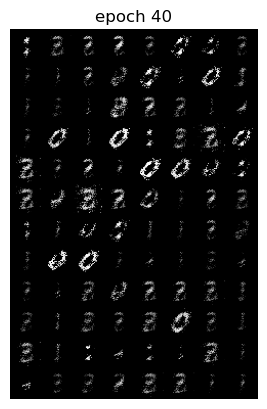

Epoch 40 of 200
Generator loss: 0.02129783, Discriminator loss: 0.00518275


118it [00:08, 14.45it/s]                         


Epoch 41 of 200
Generator loss: 0.02937387, Discriminator loss: 0.00290469


118it [00:08, 14.01it/s]                         


Epoch 42 of 200
Generator loss: 0.02388269, Discriminator loss: 0.00706910


118it [00:08, 13.99it/s]                         


Epoch 43 of 200
Generator loss: 0.02348733, Discriminator loss: 0.00495504


118it [00:08, 14.02it/s]                         


Epoch 44 of 200
Generator loss: 0.02326648, Discriminator loss: 0.00472901


118it [00:08, 14.00it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


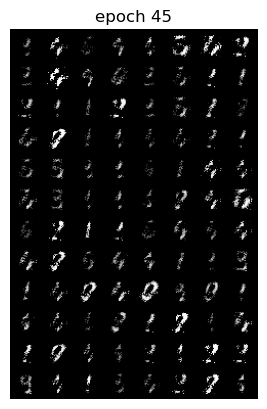

Epoch 45 of 200
Generator loss: 0.02371810, Discriminator loss: 0.00367307


118it [00:08, 14.02it/s]                         


Epoch 46 of 200
Generator loss: 0.03177443, Discriminator loss: 0.00198571


118it [00:08, 14.04it/s]                         


Epoch 47 of 200
Generator loss: 0.01910720, Discriminator loss: 0.00586707


118it [00:08, 13.92it/s]                         


Epoch 48 of 200
Generator loss: 0.02193841, Discriminator loss: 0.00421817


118it [00:08, 13.98it/s]                         


Epoch 49 of 200
Generator loss: 0.02344142, Discriminator loss: 0.00469733


118it [00:08, 13.98it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


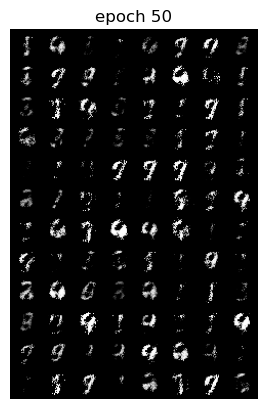

Epoch 50 of 200
Generator loss: 0.02661113, Discriminator loss: 0.00555546


118it [00:08, 14.04it/s]                         


Epoch 51 of 200
Generator loss: 0.02519681, Discriminator loss: 0.00534899


118it [00:08, 14.12it/s]                         


Epoch 52 of 200
Generator loss: 0.02649809, Discriminator loss: 0.00488960


118it [00:08, 13.79it/s]                         


Epoch 53 of 200
Generator loss: 0.01935202, Discriminator loss: 0.00497573


118it [00:08, 14.10it/s]                         


Epoch 54 of 200
Generator loss: 0.02085952, Discriminator loss: 0.00397417


118it [00:08, 14.21it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


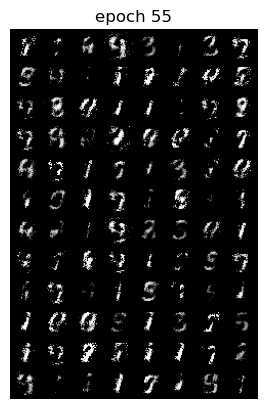

Epoch 55 of 200
Generator loss: 0.02633271, Discriminator loss: 0.00502963


118it [00:08, 14.12it/s]                         


Epoch 56 of 200
Generator loss: 0.02492195, Discriminator loss: 0.00416091


118it [00:08, 14.52it/s]                         


Epoch 57 of 200
Generator loss: 0.01930784, Discriminator loss: 0.00606251


118it [00:08, 14.23it/s]                         


Epoch 58 of 200
Generator loss: 0.01900721, Discriminator loss: 0.00524162


118it [00:08, 14.18it/s]                         


Epoch 59 of 200
Generator loss: 0.02495830, Discriminator loss: 0.00548505


118it [00:08, 14.47it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


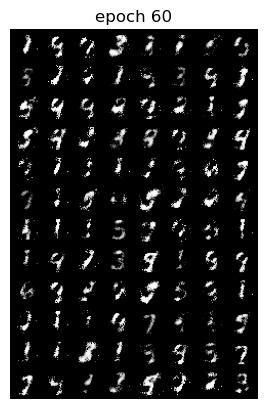

Epoch 60 of 200
Generator loss: 0.02053817, Discriminator loss: 0.00566776


118it [00:08, 14.42it/s]                         


Epoch 61 of 200
Generator loss: 0.02685994, Discriminator loss: 0.00443540


118it [00:08, 14.56it/s]                         


Epoch 62 of 200
Generator loss: 0.02291076, Discriminator loss: 0.00318838


118it [00:08, 14.47it/s]                         


Epoch 63 of 200
Generator loss: 0.02289049, Discriminator loss: 0.00580458


118it [00:08, 14.35it/s]                         


Epoch 64 of 200
Generator loss: 0.02328549, Discriminator loss: 0.00569314


118it [00:08, 14.53it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


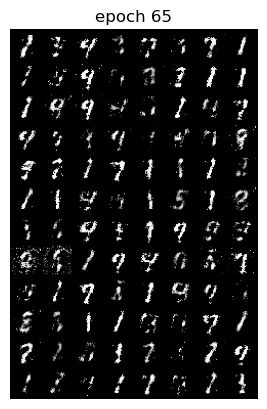

Epoch 65 of 200
Generator loss: 0.03858386, Discriminator loss: 0.00458963


118it [00:08, 14.39it/s]                         


Epoch 66 of 200
Generator loss: 0.02459571, Discriminator loss: 0.00453062


118it [00:08, 14.37it/s]                         


Epoch 67 of 200
Generator loss: 0.02568268, Discriminator loss: 0.00416001


118it [00:08, 14.40it/s]                         


Epoch 68 of 200
Generator loss: 0.02282604, Discriminator loss: 0.00425542


118it [00:08, 14.62it/s]                         


Epoch 69 of 200
Generator loss: 0.02297769, Discriminator loss: 0.00483606


118it [00:07, 15.12it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


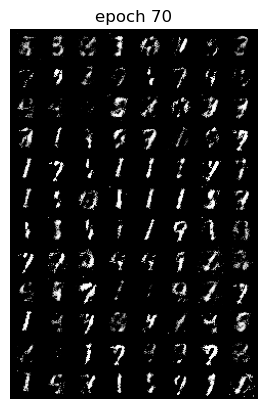

Epoch 70 of 200
Generator loss: 0.02327454, Discriminator loss: 0.00483349


118it [00:07, 15.15it/s]                         


Epoch 71 of 200
Generator loss: 0.01640783, Discriminator loss: 0.00499147


118it [00:07, 15.18it/s]                         


Epoch 72 of 200
Generator loss: 0.01906056, Discriminator loss: 0.00674442


118it [00:07, 14.78it/s]                         


Epoch 73 of 200
Generator loss: 0.02199834, Discriminator loss: 0.00697160


118it [00:07, 15.14it/s]                         


Epoch 74 of 200
Generator loss: 0.02249186, Discriminator loss: 0.00354562


118it [00:07, 14.98it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


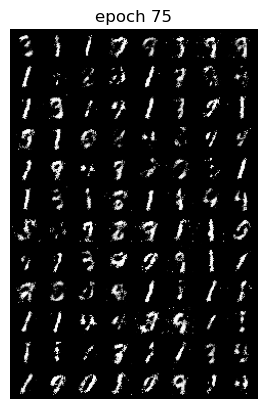

Epoch 75 of 200
Generator loss: 0.02069765, Discriminator loss: 0.00434918


118it [00:07, 15.18it/s]                         


Epoch 76 of 200
Generator loss: 0.02006372, Discriminator loss: 0.00551802


118it [00:07, 15.23it/s]                         


Epoch 77 of 200
Generator loss: 0.02446121, Discriminator loss: 0.00426663


118it [00:07, 15.22it/s]                         


Epoch 78 of 200
Generator loss: 0.01843985, Discriminator loss: 0.00613676


118it [00:07, 14.91it/s]                         


Epoch 79 of 200
Generator loss: 0.01548799, Discriminator loss: 0.00788820


118it [00:08, 14.07it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


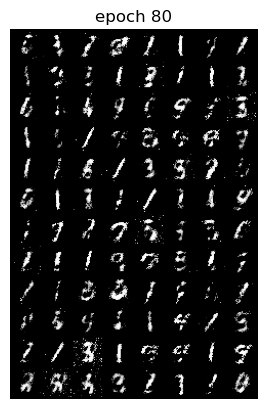

Epoch 80 of 200
Generator loss: 0.02283865, Discriminator loss: 0.00427082


118it [00:07, 14.88it/s]                         


Epoch 81 of 200
Generator loss: 0.01653462, Discriminator loss: 0.00650138


118it [00:07, 15.45it/s]                         


Epoch 82 of 200
Generator loss: 0.01939463, Discriminator loss: 0.00441163


118it [00:07, 15.31it/s]                         


Epoch 83 of 200
Generator loss: 0.02395066, Discriminator loss: 0.00364924


118it [00:07, 15.34it/s]                         


Epoch 84 of 200
Generator loss: 0.02019322, Discriminator loss: 0.00764616


118it [00:07, 15.14it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


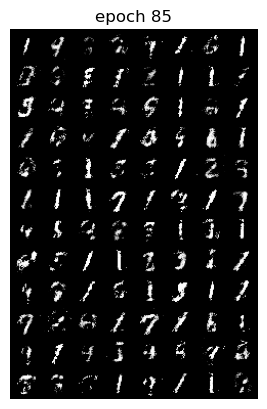

Epoch 85 of 200
Generator loss: 0.01797056, Discriminator loss: 0.00633465


118it [00:07, 15.04it/s]                         


Epoch 86 of 200
Generator loss: 0.01276815, Discriminator loss: 0.00816477


118it [00:07, 15.52it/s]                         


Epoch 87 of 200
Generator loss: 0.01558104, Discriminator loss: 0.00688883


118it [00:07, 15.41it/s]                         


Epoch 88 of 200
Generator loss: 0.01907763, Discriminator loss: 0.00694028


118it [00:07, 15.68it/s]                         


Epoch 89 of 200
Generator loss: 0.02307465, Discriminator loss: 0.00514516


118it [00:07, 15.24it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


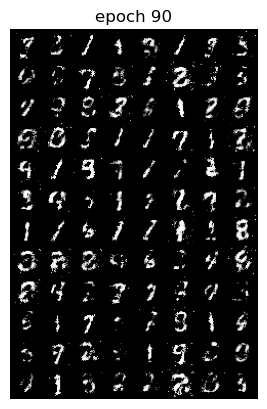

Epoch 90 of 200
Generator loss: 0.01502498, Discriminator loss: 0.00707424


118it [00:07, 15.56it/s]                         


Epoch 91 of 200
Generator loss: 0.01879759, Discriminator loss: 0.00517197


118it [00:07, 15.67it/s]                         


Epoch 92 of 200
Generator loss: 0.01554047, Discriminator loss: 0.00678715


118it [00:07, 15.29it/s]                         


Epoch 93 of 200
Generator loss: 0.01734845, Discriminator loss: 0.00681704


118it [00:07, 15.33it/s]                         


Epoch 94 of 200
Generator loss: 0.02387386, Discriminator loss: 0.00549466


118it [00:07, 15.30it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


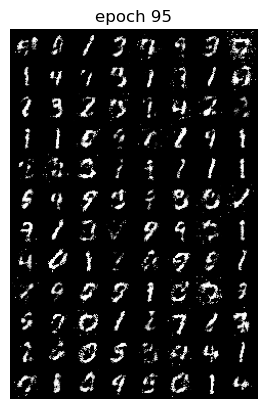

Epoch 95 of 200
Generator loss: 0.02216863, Discriminator loss: 0.00372645


118it [00:07, 15.40it/s]                         


Epoch 96 of 200
Generator loss: 0.02195067, Discriminator loss: 0.00617842


118it [00:07, 15.33it/s]                         


Epoch 97 of 200
Generator loss: 0.02459858, Discriminator loss: 0.00630900


118it [00:07, 15.44it/s]                         


Epoch 98 of 200
Generator loss: 0.01539949, Discriminator loss: 0.00723950


118it [00:07, 15.53it/s]                         


Epoch 99 of 200
Generator loss: 0.01280582, Discriminator loss: 0.00814827


118it [00:07, 15.55it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


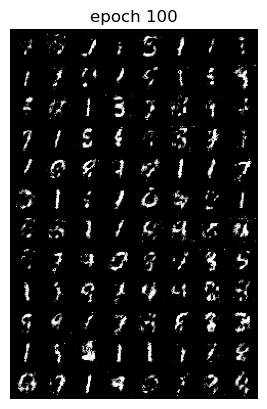

Epoch 100 of 200
Generator loss: 0.02251280, Discriminator loss: 0.00625812


118it [00:07, 15.47it/s]                         


Epoch 101 of 200
Generator loss: 0.02271688, Discriminator loss: 0.00467033


118it [00:07, 15.24it/s]                         


Epoch 102 of 200
Generator loss: 0.01683735, Discriminator loss: 0.00719454


118it [00:07, 15.37it/s]                         


Epoch 103 of 200
Generator loss: 0.01651666, Discriminator loss: 0.00601624


118it [00:07, 15.37it/s]                         


Epoch 104 of 200
Generator loss: 0.01497514, Discriminator loss: 0.00740788


118it [00:07, 15.26it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


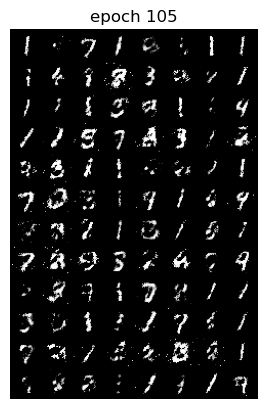

Epoch 105 of 200
Generator loss: 0.02337840, Discriminator loss: 0.00354609


118it [00:07, 15.37it/s]                         


Epoch 106 of 200
Generator loss: 0.01876001, Discriminator loss: 0.00529179


118it [00:07, 15.43it/s]                         


Epoch 107 of 200
Generator loss: 0.02125929, Discriminator loss: 0.00558180


118it [00:07, 15.29it/s]                         


Epoch 108 of 200
Generator loss: 0.01747326, Discriminator loss: 0.00611055


118it [00:07, 15.41it/s]                         


Epoch 109 of 200
Generator loss: 0.01160966, Discriminator loss: 0.00946201


118it [00:07, 15.51it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


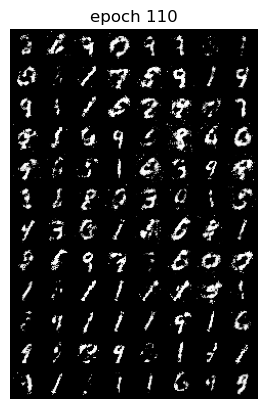

Epoch 110 of 200
Generator loss: 0.01288258, Discriminator loss: 0.00705311


118it [00:07, 15.40it/s]                         


Epoch 111 of 200
Generator loss: 0.01473903, Discriminator loss: 0.00763684


118it [00:07, 15.52it/s]                         


Epoch 112 of 200
Generator loss: 0.01390318, Discriminator loss: 0.00790452


118it [00:07, 15.37it/s]                         


Epoch 113 of 200
Generator loss: 0.01318847, Discriminator loss: 0.00711758


118it [00:07, 15.52it/s]                         


Epoch 114 of 200
Generator loss: 0.01812429, Discriminator loss: 0.00531285


118it [00:07, 15.51it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


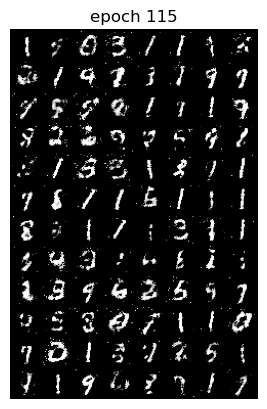

Epoch 115 of 200
Generator loss: 0.01911100, Discriminator loss: 0.00589254


118it [00:07, 15.62it/s]                         


Epoch 116 of 200
Generator loss: 0.01827269, Discriminator loss: 0.00741855


118it [00:07, 15.64it/s]                         


Epoch 117 of 200
Generator loss: 0.01868498, Discriminator loss: 0.00728360


118it [00:07, 15.56it/s]                         


Epoch 118 of 200
Generator loss: 0.01372280, Discriminator loss: 0.00810291


118it [00:07, 15.46it/s]                         


Epoch 119 of 200
Generator loss: 0.01617095, Discriminator loss: 0.00711067


118it [00:07, 15.41it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


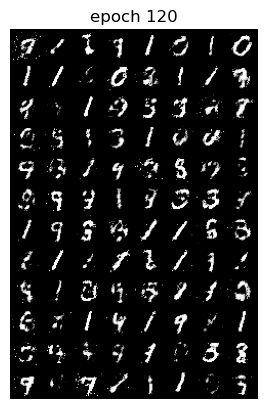

Epoch 120 of 200
Generator loss: 0.01195281, Discriminator loss: 0.00831361


118it [00:07, 15.52it/s]                         


Epoch 121 of 200
Generator loss: 0.01499243, Discriminator loss: 0.00841041


118it [00:07, 15.59it/s]                         


Epoch 122 of 200
Generator loss: 0.01598312, Discriminator loss: 0.00675167


118it [00:07, 15.04it/s]                         


Epoch 123 of 200
Generator loss: 0.01782983, Discriminator loss: 0.00760365


118it [00:08, 14.30it/s]                         


Epoch 124 of 200
Generator loss: 0.01245789, Discriminator loss: 0.00695478


118it [00:07, 15.20it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


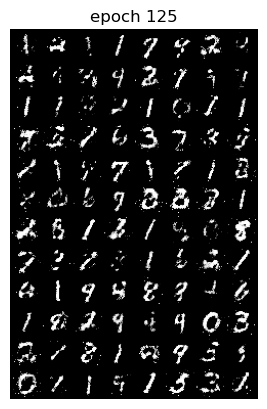

Epoch 125 of 200
Generator loss: 0.01512003, Discriminator loss: 0.00840282


118it [00:08, 14.69it/s]                         


Epoch 126 of 200
Generator loss: 0.01369700, Discriminator loss: 0.00813954


118it [00:07, 15.59it/s]                         


Epoch 127 of 200
Generator loss: 0.01558861, Discriminator loss: 0.00634334


118it [00:07, 15.63it/s]                         


Epoch 128 of 200
Generator loss: 0.01813956, Discriminator loss: 0.00593726


118it [00:07, 15.63it/s]                         


Epoch 129 of 200
Generator loss: 0.01325333, Discriminator loss: 0.00656031


118it [00:07, 15.56it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


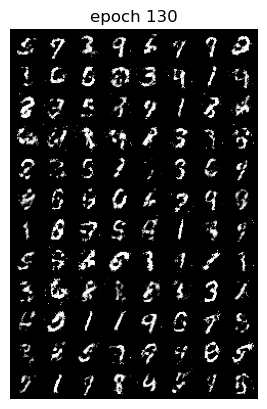

Epoch 130 of 200
Generator loss: 0.01439052, Discriminator loss: 0.00806966


118it [00:07, 15.66it/s]                         


Epoch 131 of 200
Generator loss: 0.01754022, Discriminator loss: 0.00759347


118it [00:07, 15.69it/s]                         


Epoch 132 of 200
Generator loss: 0.01328839, Discriminator loss: 0.00748283


118it [00:07, 15.63it/s]                         


Epoch 133 of 200
Generator loss: 0.01258369, Discriminator loss: 0.00771470


118it [00:07, 15.63it/s]                         


Epoch 134 of 200
Generator loss: 0.01120385, Discriminator loss: 0.01007649


118it [00:07, 15.66it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


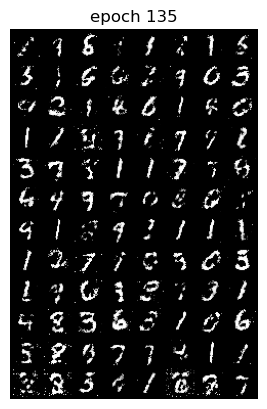

Epoch 135 of 200
Generator loss: 0.01501067, Discriminator loss: 0.00847350


118it [00:07, 15.38it/s]                         


Epoch 136 of 200
Generator loss: 0.01517606, Discriminator loss: 0.00727242


118it [00:07, 15.25it/s]                         


Epoch 137 of 200
Generator loss: 0.01425199, Discriminator loss: 0.00706423


118it [00:07, 15.35it/s]                         


Epoch 138 of 200
Generator loss: 0.01584355, Discriminator loss: 0.00681170


118it [00:07, 15.54it/s]                         


Epoch 139 of 200
Generator loss: 0.01508076, Discriminator loss: 0.00780147


118it [00:07, 15.48it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


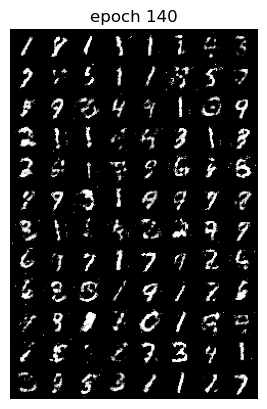

Epoch 140 of 200
Generator loss: 0.01547111, Discriminator loss: 0.00669811


118it [00:07, 15.29it/s]                         


Epoch 141 of 200
Generator loss: 0.00980900, Discriminator loss: 0.00840864


118it [00:07, 15.38it/s]                         


Epoch 142 of 200
Generator loss: 0.01368463, Discriminator loss: 0.00639976


118it [00:07, 15.51it/s]                         


Epoch 143 of 200
Generator loss: 0.01220932, Discriminator loss: 0.00815085


118it [00:07, 15.49it/s]                         


Epoch 144 of 200
Generator loss: 0.01663443, Discriminator loss: 0.00647867


118it [00:07, 15.59it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


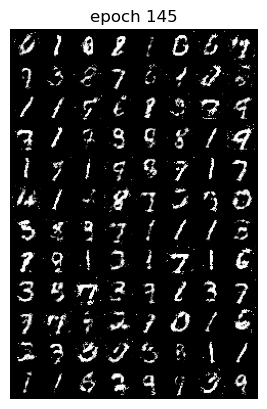

Epoch 145 of 200
Generator loss: 0.01206025, Discriminator loss: 0.00909965


118it [00:07, 15.44it/s]                         


Epoch 146 of 200
Generator loss: 0.01235882, Discriminator loss: 0.00916014


118it [00:07, 15.53it/s]                         


Epoch 147 of 200
Generator loss: 0.01619771, Discriminator loss: 0.00886393


118it [00:07, 15.71it/s]                         


Epoch 148 of 200
Generator loss: 0.01608831, Discriminator loss: 0.00731116


118it [00:07, 14.91it/s]                         


Epoch 149 of 200
Generator loss: 0.01357494, Discriminator loss: 0.00782250


118it [00:07, 15.44it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


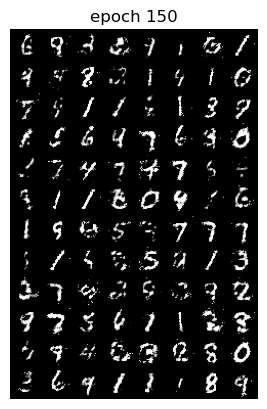

Epoch 150 of 200
Generator loss: 0.01187731, Discriminator loss: 0.00778859


118it [00:07, 15.85it/s]                         


Epoch 151 of 200
Generator loss: 0.01289327, Discriminator loss: 0.00765778


118it [00:07, 15.93it/s]                         


Epoch 152 of 200
Generator loss: 0.01342365, Discriminator loss: 0.00685338


118it [00:07, 16.00it/s]                         


Epoch 153 of 200
Generator loss: 0.01451434, Discriminator loss: 0.00900186


118it [00:07, 15.64it/s]                         


Epoch 154 of 200
Generator loss: 0.01712217, Discriminator loss: 0.00812893


118it [00:07, 16.09it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


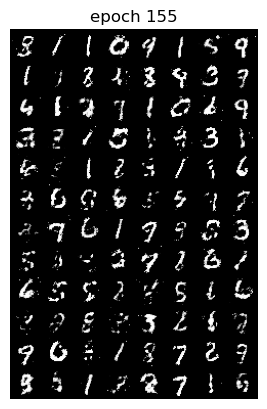

Epoch 155 of 200
Generator loss: 0.01728156, Discriminator loss: 0.00694111


118it [00:07, 16.20it/s]                         


Epoch 156 of 200
Generator loss: 0.01410726, Discriminator loss: 0.00791869


118it [00:07, 16.07it/s]                         


Epoch 157 of 200
Generator loss: 0.01395865, Discriminator loss: 0.00674561


118it [00:07, 16.14it/s]                         


Epoch 158 of 200
Generator loss: 0.01234147, Discriminator loss: 0.00915659


118it [00:07, 16.33it/s]                         


Epoch 159 of 200
Generator loss: 0.01021093, Discriminator loss: 0.00919346


118it [00:07, 16.32it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


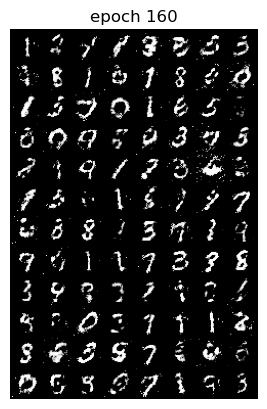

Epoch 160 of 200
Generator loss: 0.01292803, Discriminator loss: 0.00915145


118it [00:07, 16.15it/s]                         


Epoch 161 of 200
Generator loss: 0.00908934, Discriminator loss: 0.00987776


118it [00:07, 16.22it/s]                         


Epoch 162 of 200
Generator loss: 0.01161609, Discriminator loss: 0.00895500


118it [00:07, 16.18it/s]                         


Epoch 163 of 200
Generator loss: 0.01665414, Discriminator loss: 0.00863214


118it [00:07, 16.34it/s]                         


Epoch 164 of 200
Generator loss: 0.01246526, Discriminator loss: 0.00703535


118it [00:07, 16.32it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


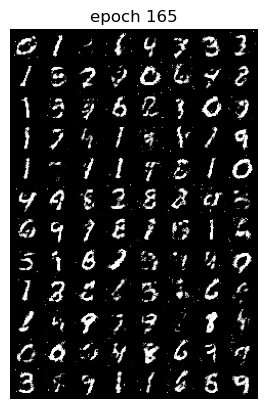

Epoch 165 of 200
Generator loss: 0.01374739, Discriminator loss: 0.00828904


118it [00:07, 16.17it/s]                         


Epoch 166 of 200
Generator loss: 0.00968151, Discriminator loss: 0.01008015


118it [00:07, 16.39it/s]                         


Epoch 167 of 200
Generator loss: 0.01520259, Discriminator loss: 0.00933376


118it [00:07, 16.26it/s]                         


Epoch 168 of 200
Generator loss: 0.01330957, Discriminator loss: 0.00705441


118it [00:07, 16.29it/s]                         


Epoch 169 of 200
Generator loss: 0.01180813, Discriminator loss: 0.00928171


118it [00:07, 16.35it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


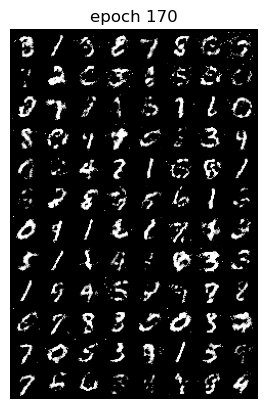

Epoch 170 of 200
Generator loss: 0.01642138, Discriminator loss: 0.00817326


118it [00:07, 16.22it/s]                         


Epoch 171 of 200
Generator loss: 0.01083421, Discriminator loss: 0.00884705


118it [00:07, 16.28it/s]                         


Epoch 172 of 200
Generator loss: 0.00974569, Discriminator loss: 0.00916838


118it [00:07, 16.25it/s]                         


Epoch 173 of 200
Generator loss: 0.01161028, Discriminator loss: 0.01083570


118it [00:07, 16.22it/s]                         


Epoch 174 of 200
Generator loss: 0.00937618, Discriminator loss: 0.00910491


118it [00:07, 16.36it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


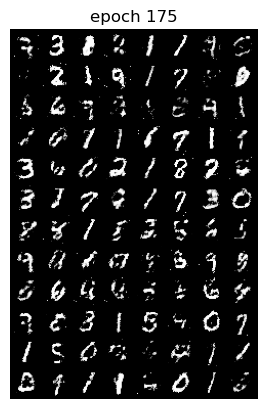

Epoch 175 of 200
Generator loss: 0.01052857, Discriminator loss: 0.00804716


118it [00:07, 16.28it/s]                         


Epoch 176 of 200
Generator loss: 0.01094258, Discriminator loss: 0.00829909


118it [00:07, 16.37it/s]                         


Epoch 177 of 200
Generator loss: 0.01288017, Discriminator loss: 0.00820553


118it [00:07, 16.35it/s]                         


Epoch 178 of 200
Generator loss: 0.01667696, Discriminator loss: 0.00813794


118it [00:07, 16.24it/s]                         


Epoch 179 of 200
Generator loss: 0.01318327, Discriminator loss: 0.00864941


118it [00:07, 16.41it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


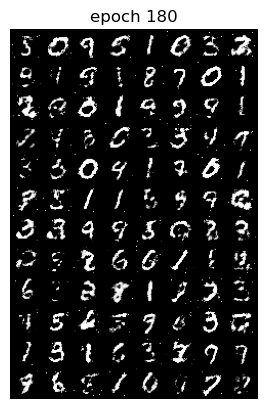

Epoch 180 of 200
Generator loss: 0.00942523, Discriminator loss: 0.00849945


118it [00:07, 16.21it/s]                         


Epoch 181 of 200
Generator loss: 0.01108758, Discriminator loss: 0.00950821


118it [00:07, 16.34it/s]                         


Epoch 182 of 200
Generator loss: 0.01231297, Discriminator loss: 0.00889188


118it [00:07, 16.35it/s]                         


Epoch 183 of 200
Generator loss: 0.01120295, Discriminator loss: 0.00788557


118it [00:07, 16.37it/s]                         


Epoch 184 of 200
Generator loss: 0.01175545, Discriminator loss: 0.00804841


118it [00:07, 16.27it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


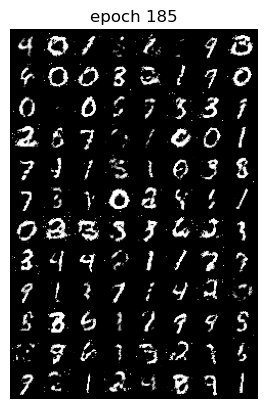

Epoch 185 of 200
Generator loss: 0.01332344, Discriminator loss: 0.00721271


118it [00:07, 16.21it/s]                         


Epoch 186 of 200
Generator loss: 0.00898210, Discriminator loss: 0.01122687


118it [00:07, 16.31it/s]                         


Epoch 187 of 200
Generator loss: 0.01339818, Discriminator loss: 0.01034760


118it [00:07, 16.27it/s]                         


Epoch 188 of 200
Generator loss: 0.01102760, Discriminator loss: 0.00958345


118it [00:07, 16.34it/s]                         


Epoch 189 of 200
Generator loss: 0.00999783, Discriminator loss: 0.00897953


118it [00:07, 16.28it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


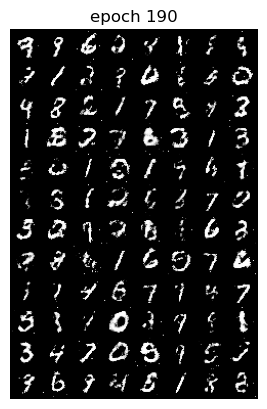

Epoch 190 of 200
Generator loss: 0.01028167, Discriminator loss: 0.00964646


118it [00:07, 16.28it/s]                         


Epoch 191 of 200
Generator loss: 0.01157740, Discriminator loss: 0.00827674


118it [00:07, 16.37it/s]                         


Epoch 192 of 200
Generator loss: 0.01042382, Discriminator loss: 0.00858556


118it [00:07, 16.34it/s]                         


Epoch 193 of 200
Generator loss: 0.01063206, Discriminator loss: 0.01069610


118it [00:07, 16.31it/s]                         


Epoch 194 of 200
Generator loss: 0.01370966, Discriminator loss: 0.01044494


118it [00:07, 15.63it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


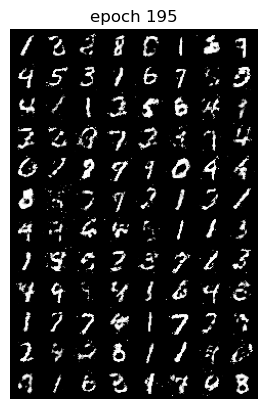

Epoch 195 of 200
Generator loss: 0.01189249, Discriminator loss: 0.00866970


118it [00:07, 15.70it/s]                         


Epoch 196 of 200
Generator loss: 0.01322809, Discriminator loss: 0.00770102


118it [00:07, 15.18it/s]                         


Epoch 197 of 200
Generator loss: 0.01308306, Discriminator loss: 0.00864971


118it [00:07, 16.07it/s]                         


Epoch 198 of 200
Generator loss: 0.01280573, Discriminator loss: 0.00823556


118it [00:07, 15.85it/s]                         


Epoch 199 of 200
Generator loss: 0.01129381, Discriminator loss: 0.00908630


118it [00:07, 15.92it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


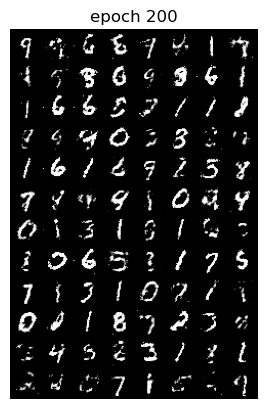

Epoch 200 of 200
Generator loss: 0.00840846, Discriminator loss: 0.00982350


In [20]:
torch.manual_seed(7777)

def generator_loss(output, true_label):
    ############ YOUR CODE HERE ##########
    return criterion(output, true_label)
    
    
    ######################################
    
def discriminator_loss(output, true_label):
    ############ YOUR CODE HERE ##########
    return criterion(output, true_label)
    
    
    ######################################
    
losses_g = [] # to store generator loss after each epoch
losses_d = [] # to store discriminator loss after each epoch
images = [] # to store images generatd by the generator
epochs = 200
for epoch in range(epochs):
    loss_g = 0.0
    loss_d = 0.0
    for bi, data in tqdm(enumerate(train_loader), total=int(len(train_data)/train_loader.batch_size)):
        ############ YOUR CODE HERE ########## 
        real_images, _ = data
        batch_size = real_images.size(0)
        noise = create_noise(batch_size, nz)
        fake_sample = generator(noise)
        disc_r_samp = discriminator(real_images).view(-1)
        lossD_realSample = criterion(disc_r_samp, label_real(batch_size))
        disc_f_samp = discriminator(fake_sample).view(-1)
        lossD_fakeSample = criterion(disc_f_samp, label_fake(batch_size)) 
        loss_d = (lossD_realSample + lossD_fakeSample)
        discriminator.zero_grad()
        loss_d.backward(retain_graph=True)
        optim_d.step()
        
        lossD_fakeSample = discriminator(fake_sample).view(-1)
        loss_g = criterion(lossD_fakeSample, label_real(batch_size))        
        generator.zero_grad()
        loss_g.backward()
        optim_g.step()
        
        ######################################
    
    
    # create the final fake image for the epoch
    generated_img = generator(noise).cpu().detach()
    
    # make the images as grid
    generated_img = make_grid(generated_img)
    
    # visualize generated images
    if (epoch + 1) % 5 == 0:
        plt.imshow(generated_img.permute(1, 2, 0))
        plt.title(f'epoch {epoch+1}')
        plt.axis('off')
        plt.show()
    
    # save the generated torch tensor models to disk
    save_generator_image(generated_img, f"outputs/gen_img{epoch+1}.png")
    images.append(generated_img)
    epoch_loss_g = loss_g / bi # total generator loss for the epoch
    epoch_loss_d = loss_d / bi # total discriminator loss for the epoch
    losses_g.append(epoch_loss_g)
    losses_d.append(epoch_loss_d)
    
    print(f"Epoch {epoch+1} of {epochs}")
    print(f"Generator loss: {epoch_loss_g:.8f}, Discriminator loss: {epoch_loss_d:.8f}")

In [21]:
print('DONE TRAINING')
torch.save(generator.state_dict(), 'outputs/generator.pth')

DONE TRAINING


In [22]:
# save the generated images as GIF file
imgs = [np.array(to_pil_image(img)) for img in images]
imageio.mimsave('outputs/generator_images.gif', imgs)

In [23]:
losses_g_up = [a.detach().numpy() if a!=0 else a for a in losses_g]
losses_d_up = [a.detach().numpy() if a!=0 else a for a in losses_d]

In [24]:
losses_g_with_updates = losses_g
losses_d_with_updates = losses_d


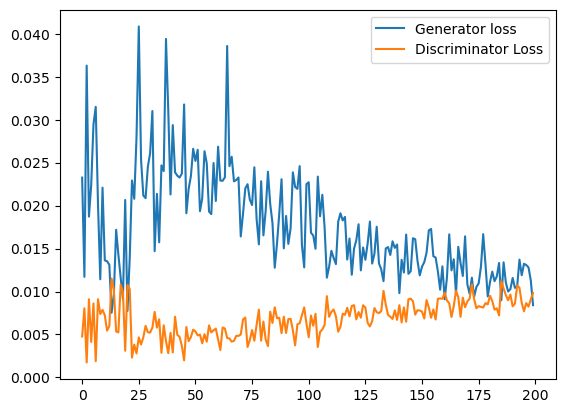

In [25]:
# plot and save the generator and discriminator loss
plt.figure()
plt.plot(losses_g_up, label='Generator loss')
plt.plot(losses_d_up, label='Discriminator Loss')
plt.legend()
plt.savefig('outputs/loss.png')

In [26]:
generator = Generator(nz).to(device)
discriminator = Discriminator().to(device)
print('##### GENERATOR #####')
print(generator)
print('######################')
print('\n##### DISCRIMINATOR #####')
print(discriminator)
print('######################')

##### GENERATOR #####
Generator(
  (main): Sequential(
    (0): Linear(in_features=128, out_features=256, bias=True)
    (1): LeakyReLU(negative_slope=0.2)
    (2): Linear(in_features=256, out_features=512, bias=True)
    (3): LeakyReLU(negative_slope=0.2)
    (4): Linear(in_features=512, out_features=1024, bias=True)
    (5): LeakyReLU(negative_slope=0.2)
    (6): Linear(in_features=1024, out_features=784, bias=True)
    (7): Tanh()
  )
)
######################

##### DISCRIMINATOR #####
Discriminator(
  (main): Sequential(
    (0): Linear(in_features=784, out_features=1024, bias=True)
    (1): LeakyReLU(negative_slope=0.2)
    (2): Dropout(p=0.3, inplace=False)
    (3): Linear(in_features=1024, out_features=512, bias=True)
    (4): LeakyReLU(negative_slope=0.2)
    (5): Dropout(p=0.3, inplace=False)
    (6): Linear(in_features=512, out_features=256, bias=True)
    (7): LeakyReLU(negative_slope=0.2)
    (8): Dropout(p=0.3, inplace=False)
    (9): Linear(in_features=256, out_features=1

In [27]:
# optimizers
optim_g = optim.Adam(generator.parameters(), lr=0.0002)
optim_d = optim.Adam(discriminator.parameters(), lr=0.0002)

In [28]:
# loss function
criterion = nn.BCELoss() # Binary Cross Entropy loss

In [29]:
!mkdir outputs_b

losses_g = [] # to store generator loss after each epoch
losses_d = [] # to store discriminator loss after each epoch
images = [] # to store images generatd by the generator

118it [00:07, 15.45it/s]                         


Epoch 1 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.53it/s]                         


Epoch 2 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.64it/s]                         


Epoch 3 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.07it/s]                         


Epoch 4 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.23it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


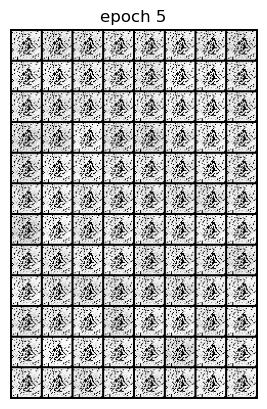

Epoch 5 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.55it/s]                         


Epoch 6 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.43it/s]                         


Epoch 7 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.55it/s]                         


Epoch 8 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.51it/s]                         


Epoch 9 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.00it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


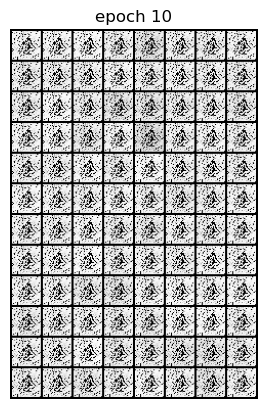

Epoch 10 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.64it/s]                         


Epoch 11 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.67it/s]                         


Epoch 12 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.57it/s]                         


Epoch 13 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.38it/s]                         


Epoch 14 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.65it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


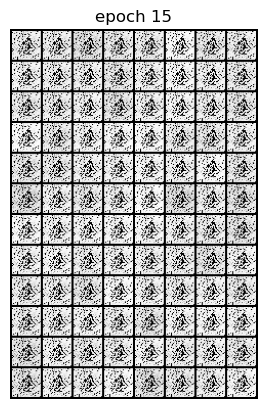

Epoch 15 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.77it/s]                         


Epoch 16 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.67it/s]                         


Epoch 17 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.84it/s]                         


Epoch 18 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.46it/s]                         


Epoch 19 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:08, 14.56it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


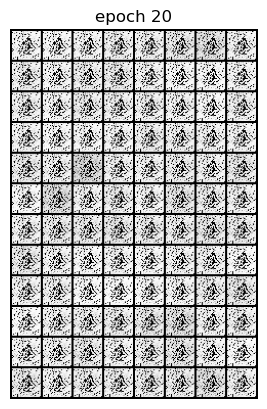

Epoch 20 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 14.80it/s]                         


Epoch 21 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.55it/s]                         


Epoch 22 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.85it/s]                         


Epoch 23 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.95it/s]                         


Epoch 24 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.01it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


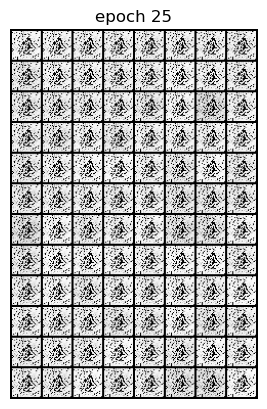

Epoch 25 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.85it/s]                         


Epoch 26 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.93it/s]                         


Epoch 27 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.99it/s]                         


Epoch 28 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.91it/s]                         


Epoch 29 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.05it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


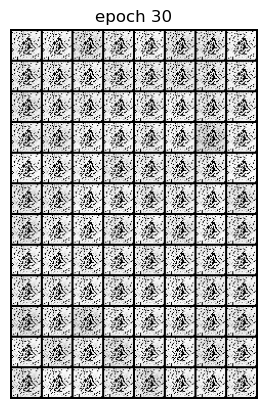

Epoch 30 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.97it/s]                         


Epoch 31 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.99it/s]                         


Epoch 32 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.01it/s]                         


Epoch 33 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.84it/s]                         


Epoch 34 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.97it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


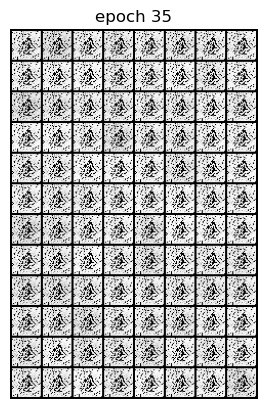

Epoch 35 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.03it/s]                         


Epoch 36 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.03it/s]                         


Epoch 37 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.03it/s]                         


Epoch 38 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.00it/s]                         


Epoch 39 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.83it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


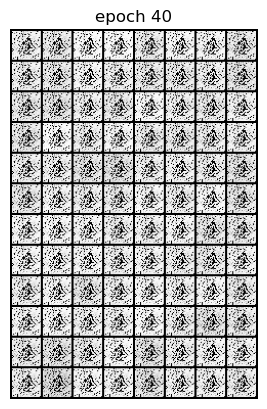

Epoch 40 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.89it/s]                         


Epoch 41 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.99it/s]                         


Epoch 42 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.97it/s]                         


Epoch 43 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.93it/s]                         


Epoch 44 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.94it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


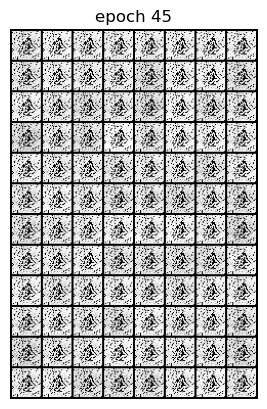

Epoch 45 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.90it/s]                         


Epoch 46 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.85it/s]                         


Epoch 47 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.95it/s]                         


Epoch 48 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.98it/s]                         


Epoch 49 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.88it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


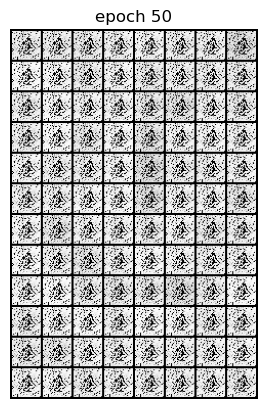

Epoch 50 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.45it/s]                         


Epoch 51 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.82it/s]                         


Epoch 52 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.79it/s]                         


Epoch 53 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.84it/s]                         


Epoch 54 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.77it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


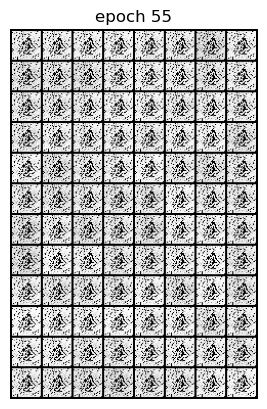

Epoch 55 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.73it/s]                         


Epoch 56 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.72it/s]                         


Epoch 57 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.81it/s]                         


Epoch 58 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.80it/s]                         


Epoch 59 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.80it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


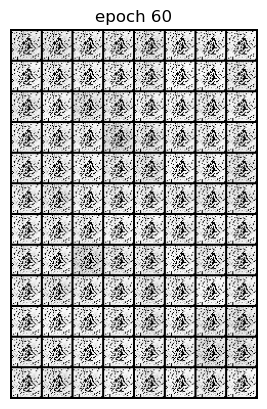

Epoch 60 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.72it/s]                         


Epoch 61 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.83it/s]                         


Epoch 62 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.82it/s]                         


Epoch 63 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.88it/s]                         


Epoch 64 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.82it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


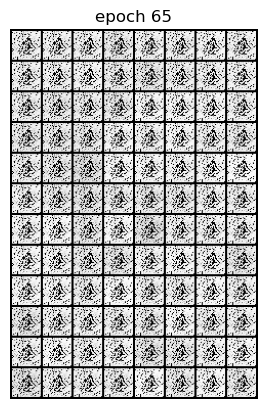

Epoch 65 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 14.83it/s]                         


Epoch 66 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.45it/s]                         


Epoch 67 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.06it/s]                         


Epoch 68 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.95it/s]                         


Epoch 69 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.86it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


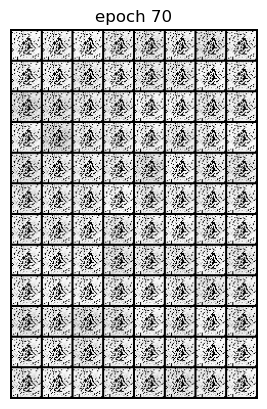

Epoch 70 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.48it/s]                         


Epoch 71 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.59it/s]                         


Epoch 72 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.53it/s]                         


Epoch 73 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.17it/s]                         


Epoch 74 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.06it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


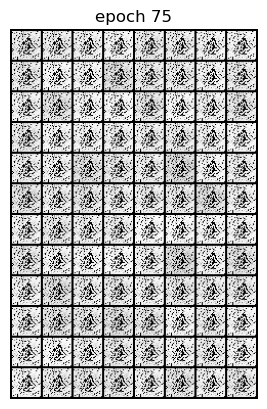

Epoch 75 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.97it/s]                         


Epoch 76 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.18it/s]                         


Epoch 77 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.13it/s]                         


Epoch 78 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.07it/s]                         


Epoch 79 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.09it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


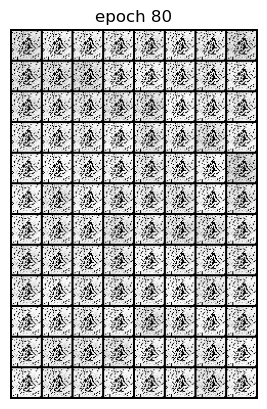

Epoch 80 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.05it/s]                         


Epoch 81 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.12it/s]                         


Epoch 82 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.10it/s]                         


Epoch 83 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.10it/s]                         


Epoch 84 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.96it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


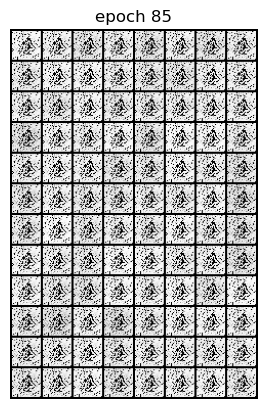

Epoch 85 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.03it/s]                         


Epoch 86 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.12it/s]                         


Epoch 87 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.17it/s]                         


Epoch 88 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.18it/s]                         


Epoch 89 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.02it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


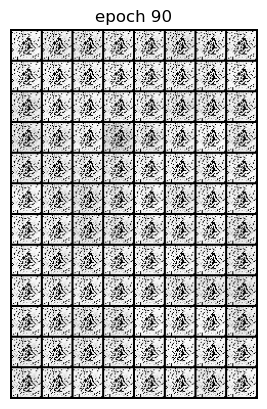

Epoch 90 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.04it/s]                         


Epoch 91 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.14it/s]                         


Epoch 92 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.09it/s]                         


Epoch 93 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.19it/s]                         


Epoch 94 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.04it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


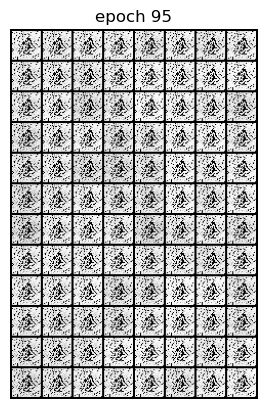

Epoch 95 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.73it/s]                         


Epoch 96 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.12it/s]                         


Epoch 97 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.06it/s]                         


Epoch 98 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.04it/s]                         


Epoch 99 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.05it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


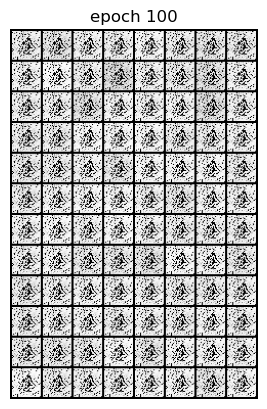

Epoch 100 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.91it/s]                         


Epoch 101 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.89it/s]                         


Epoch 102 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.20it/s]                         


Epoch 103 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.00it/s]                         


Epoch 104 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.06it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


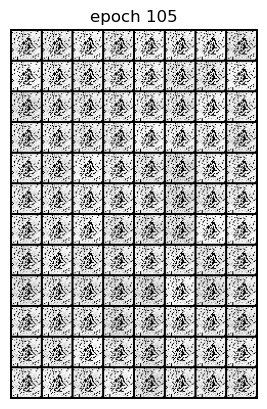

Epoch 105 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.97it/s]                         


Epoch 106 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.82it/s]                         


Epoch 107 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.86it/s]                         


Epoch 108 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.76it/s]                         


Epoch 109 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.97it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


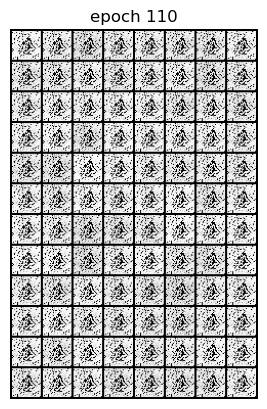

Epoch 110 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.91it/s]                         


Epoch 111 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.86it/s]                         


Epoch 112 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.82it/s]                         


Epoch 113 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.90it/s]                         


Epoch 114 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.91it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


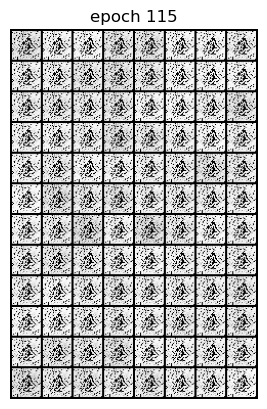

Epoch 115 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.96it/s]                         


Epoch 116 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.70it/s]                         


Epoch 117 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.99it/s]                         


Epoch 118 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.81it/s]                         


Epoch 119 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.05it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


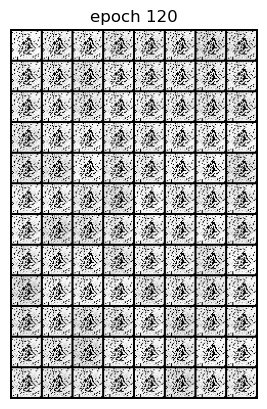

Epoch 120 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.91it/s]                         


Epoch 121 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.01it/s]                         


Epoch 122 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.09it/s]                         


Epoch 123 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.01it/s]                         


Epoch 124 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.97it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


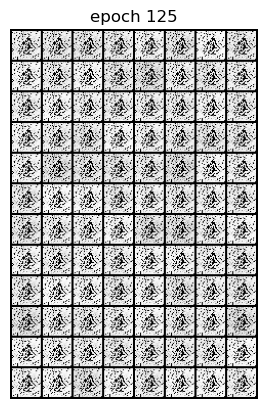

Epoch 125 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 16.03it/s]                         


Epoch 126 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.36it/s]                         


Epoch 127 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 14.99it/s]                         


Epoch 128 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.19it/s]                         


Epoch 129 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 14.90it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


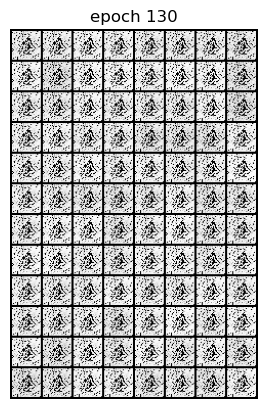

Epoch 130 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 14.99it/s]                         


Epoch 131 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.04it/s]                         


Epoch 132 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.18it/s]                         


Epoch 133 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.32it/s]                         


Epoch 134 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.21it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


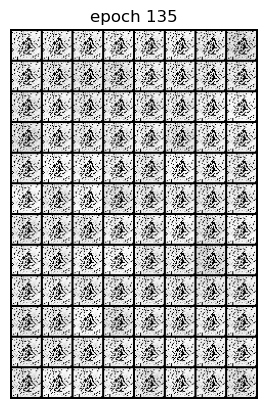

Epoch 135 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 14.99it/s]                         


Epoch 136 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.27it/s]                         


Epoch 137 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.33it/s]                         


Epoch 138 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.27it/s]                         


Epoch 139 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.33it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


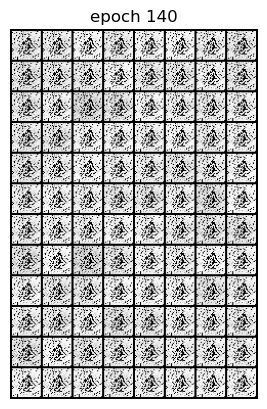

Epoch 140 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.03it/s]                         


Epoch 141 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.36it/s]                         


Epoch 142 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.45it/s]                         


Epoch 143 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.43it/s]                         


Epoch 144 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.41it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


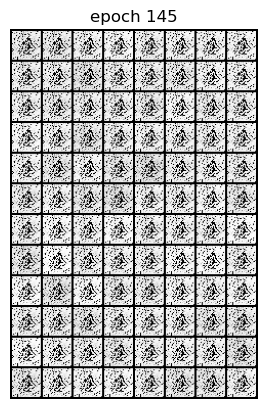

Epoch 145 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.17it/s]                         


Epoch 146 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.31it/s]                         


Epoch 147 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.50it/s]                         


Epoch 148 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.51it/s]                         


Epoch 149 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.55it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


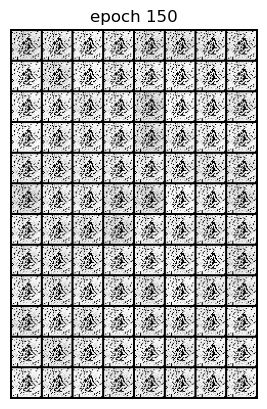

Epoch 150 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.35it/s]                         


Epoch 151 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.50it/s]                         


Epoch 152 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.48it/s]                         


Epoch 153 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.47it/s]                         


Epoch 154 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.55it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


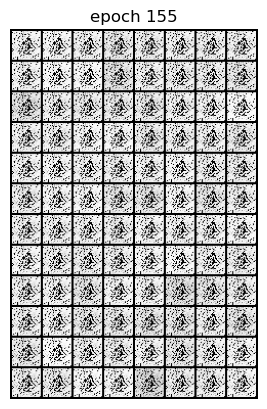

Epoch 155 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.45it/s]                         


Epoch 156 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.58it/s]                         


Epoch 157 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.51it/s]                         


Epoch 158 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.64it/s]                         


Epoch 159 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.64it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


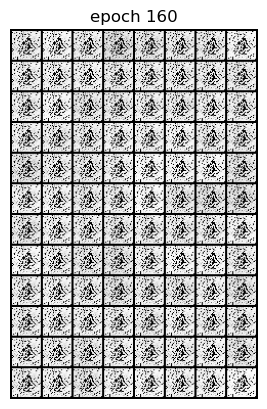

Epoch 160 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.51it/s]                         


Epoch 161 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.68it/s]                         


Epoch 162 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.66it/s]                         


Epoch 163 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.49it/s]                         


Epoch 164 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.59it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


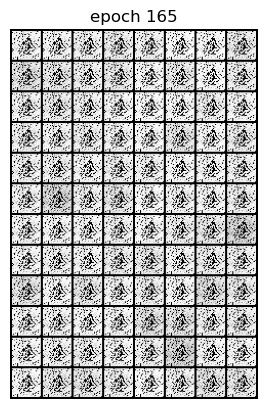

Epoch 165 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.52it/s]                         


Epoch 166 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.69it/s]                         


Epoch 167 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.69it/s]                         


Epoch 168 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.70it/s]                         


Epoch 169 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.58it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


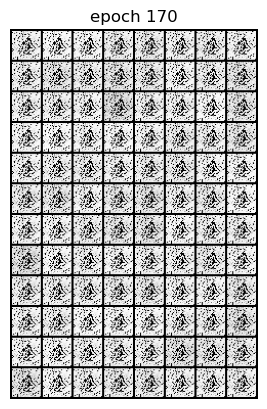

Epoch 170 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.53it/s]                         


Epoch 171 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.69it/s]                         


Epoch 172 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.78it/s]                         


Epoch 173 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.71it/s]                         


Epoch 174 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.27it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


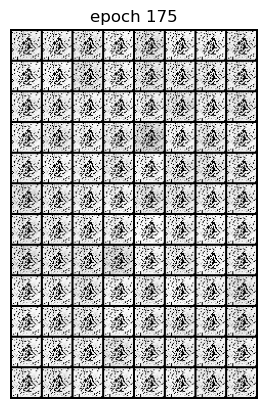

Epoch 175 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.65it/s]                         


Epoch 176 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.82it/s]                         


Epoch 177 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.85it/s]                         


Epoch 178 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.80it/s]                         


Epoch 179 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.82it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


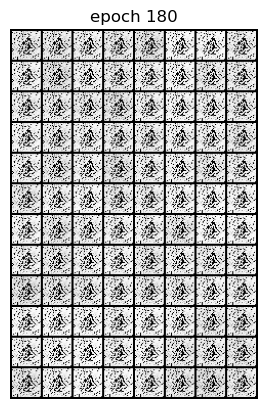

Epoch 180 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.56it/s]                         


Epoch 181 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.97it/s]                         


Epoch 182 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.84it/s]                         


Epoch 183 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.86it/s]                         


Epoch 184 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.90it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


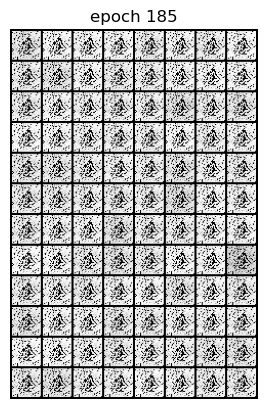

Epoch 185 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.76it/s]                         


Epoch 186 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.78it/s]                         


Epoch 187 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.97it/s]                         


Epoch 188 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.91it/s]                         


Epoch 189 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.90it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


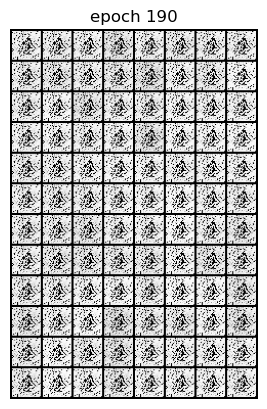

Epoch 190 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.79it/s]                         


Epoch 191 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.92it/s]                         


Epoch 192 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.66it/s]                         


Epoch 193 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.81it/s]                         


Epoch 194 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.86it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


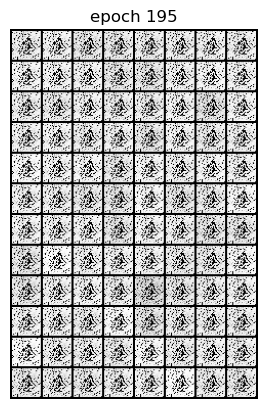

Epoch 195 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.67it/s]                         


Epoch 196 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.91it/s]                         


Epoch 197 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.76it/s]                         


Epoch 198 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.84it/s]                         


Epoch 199 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


118it [00:07, 15.22it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


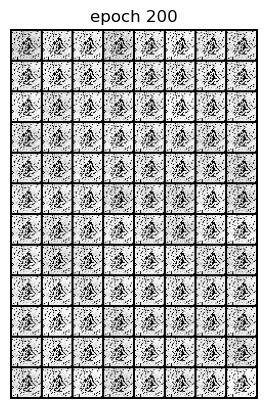

Epoch 200 of 200
Generator loss: 0.00000000, Discriminator loss: 0.00000000


In [30]:
torch.manual_seed(7777)

def generator_loss(output, true_label):
    ############ YOUR CODE HERE ##########
    return criterion(output, true_label)
    
    
    ######################################
    
def discriminator_loss(output, true_label):
    ############ YOUR CODE HERE ##########
    return criterion(output, true_label)
    
    
    ######################################


for epoch in range(epochs):
    loss_g = 0.0
    loss_d = 0.0
    for bi, data in tqdm(enumerate(train_loader), total=int(len(train_data)/train_loader.batch_size)):
        ############ YOUR CODE HERE ########## 
        real_images, _ = data
        batch_size = real_images.size(0)
        noise = create_noise(batch_size, nz)
        fake_sample = generator(noise)
        disc_r_samp = discriminator(real_images).view(-1)
        lossD_realSample = criterion(disc_r_samp, label_real(batch_size))
        disc_f_samp = discriminator(fake_sample).view(-1)
        lossD_fakeSample = criterion(disc_f_samp, label_fake(batch_size)) 
        loss_d = (lossD_realSample + lossD_fakeSample)
        discriminator.zero_grad()
        loss_d.backward(retain_graph=True)
        optim_d.step()
        
        lossD_fakeSample = discriminator(fake_sample).view(-1)
        loss_g = criterion(lossD_fakeSample, label_fake(batch_size))        
        generator.zero_grad()
        loss_g.backward()
        optim_g.step()
        
        ######################################
    
    
    # create the final fake image for the epoch
    generated_img = generator(noise).cpu().detach()
    
    # make the images as grid
    generated_img = make_grid(generated_img)
    
    # visualize generated images
    if (epoch + 1) % 5 == 0:
        plt.imshow(generated_img.permute(1, 2, 0))
        plt.title(f'epoch {epoch+1}')
        plt.axis('off')
        plt.show()
    
    # save the generated torch tensor models to disk
    save_generator_image(generated_img, f"outputs_b/gen_img{epoch+1}.png")
    images.append(generated_img)
    epoch_loss_g = loss_g / bi # total generator loss for the epoch
    epoch_loss_d = loss_d / bi # total discriminator loss for the epoch
    losses_g.append(epoch_loss_g)
    losses_d.append(epoch_loss_d)
    
    print(f"Epoch {epoch+1} of {epochs}")
    print(f"Generator loss: {epoch_loss_g:.8f}, Discriminator loss: {epoch_loss_d:.8f}")

In [31]:
print('DONE TRAINING')
torch.save(generator.state_dict(), 'outputs_b/generator.pth')

DONE TRAINING


In [32]:
# save the generated images as GIF file
imgs = [np.array(to_pil_image(img)) for img in images]
imageio.mimsave('outputs_b/generator_images.gif', imgs)

In [33]:
losses_g_up = [a.detach().numpy() if a!=0 else a for a in losses_g]
losses_d_up = [a.detach().numpy() if a!=0 else a for a in losses_d]

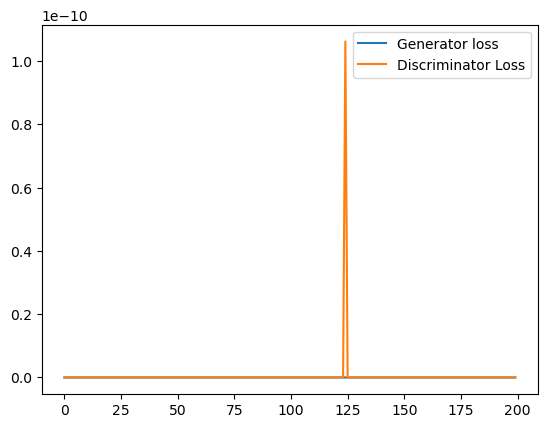

In [34]:
# plot and save the generator and discriminator loss
plt.figure()
plt.plot(losses_g_up, label='Generator loss')
plt.plot(losses_d_up, label='Discriminator Loss')
plt.legend()
plt.savefig('outputs_b/loss.png')

In [77]:
class Generator_DCGAN(nn.Module):
    def __init__(self, nz):
      nc = 1
      ngf = 28
      super(Generator_DCGAN, self).__init__()
      self.network = nn.Sequential(
          nn.ConvTranspose2d(nz, ngf*4, 4, 1, 0, bias=False),
          nn.BatchNorm2d(ngf*4),
          nn.ReLU(True),
  
          nn.ConvTranspose2d(ngf*4, ngf*2, 3, 2, 1, bias=False),
          nn.BatchNorm2d(ngf*2),
          nn.ReLU(True),
  
          nn.ConvTranspose2d(ngf*2, ngf, 4, 2, 1, bias=False),
          nn.BatchNorm2d(ngf),
          nn.ReLU(True),
  
          nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
          nn.Tanh()
      )
  
    def forward(self, input):
      output = self.network(input)
      return output

In [78]:
class Discriminator_DCGAN(nn.Module):
    def __init__(self):
        nc, ndf = 1, 28
        super(Discriminator_DCGAN, self).__init__()
        self.network = nn.Sequential(
                
                nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
                nn.LeakyReLU(0.2, inplace=True),
                
                nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
                nn.BatchNorm2d(ndf * 2),
                nn.LeakyReLU(0.2, inplace=True),
                
                nn.Conv2d(ndf * 2, ndf * 4, 3, 2, 1, bias=False),
                nn.BatchNorm2d(ndf * 4),
                nn.LeakyReLU(0.2, inplace=True),
                
                nn.Conv2d(ndf * 4, 1, 4, 1, 0, bias=False),
                nn.Sigmoid()
            )
    def forward(self, input):
        output = self.network(input)
        return output.view(-1, 1).squeeze(1)

In [79]:
# optimizers
optim_g = optim.Adam(generator.parameters(), lr=0.0002)
optim_d = optim.Adam(discriminator.parameters(), lr=0.0002)

# loss function
criterion = nn.BCELoss() # Binary Cross Entropy loss

In [80]:
device = 'mps'

In [81]:
generator = Generator_DCGAN(nz).to(device)
discriminator = Discriminator_DCGAN().to(device)
print('##### GENERATOR #####')
print(generator)
print('######################')
print('\n##### DISCRIMINATOR #####')
print(discriminator)
print('######################')

##### GENERATOR #####
Generator_DCGAN(
  (network): Sequential(
    (0): ConvTranspose2d(128, 112, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(112, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(112, 56, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(56, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(56, 28, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(28, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(28, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): Tanh()
  )
)
######################

##### DISCRIMINATOR #####
Discriminator_DCGAN(
  (network): Sequential(
    (0): Conv2d(1, 28, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): 

In [82]:
!mkdir outputs_c

losses_g = [] # to store generator loss after each epoch
losses_d = [] # to store discriminator loss after each epoch
images = [] # to store images generatd by the generator

mkdir: outputs_c: File exists


In [83]:
train_loader = DataLoader(train_data, batch_size=128, shuffle=True)

# function to create the noise vector
def create_noise_DCGAN(sample_size, nz):
    return torch.randn(sample_size, nz, 1, 1).to(device)

469it [00:20, 22.86it/s]                         


Epoch 1 of 100
Generator loss: 0.00153701, Discriminator loss: 0.00291535


469it [00:19, 24.43it/s]                         


Epoch 2 of 100
Generator loss: 0.00148311, Discriminator loss: 0.00292900


469it [00:20, 23.10it/s]                         


Epoch 3 of 100
Generator loss: 0.00144178, Discriminator loss: 0.00307859


469it [00:19, 23.63it/s]                         


Epoch 4 of 100
Generator loss: 0.00147873, Discriminator loss: 0.00300622


469it [00:19, 24.34it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


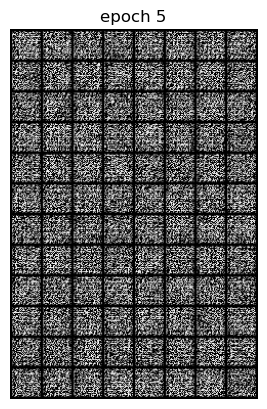

Epoch 5 of 100
Generator loss: 0.00151276, Discriminator loss: 0.00295550


469it [00:19, 24.18it/s]                         


Epoch 6 of 100
Generator loss: 0.00156327, Discriminator loss: 0.00290969


469it [00:19, 24.17it/s]                         


Epoch 7 of 100
Generator loss: 0.00154393, Discriminator loss: 0.00290524


469it [00:19, 24.41it/s]                         


Epoch 8 of 100
Generator loss: 0.00148318, Discriminator loss: 0.00297159


469it [00:19, 24.52it/s]                         


Epoch 9 of 100
Generator loss: 0.00143921, Discriminator loss: 0.00302015


469it [00:19, 24.49it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


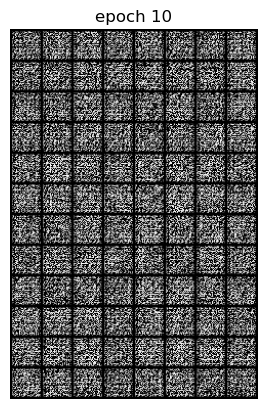

Epoch 10 of 100
Generator loss: 0.00143782, Discriminator loss: 0.00301085


469it [00:19, 24.47it/s]                         


Epoch 11 of 100
Generator loss: 0.00148148, Discriminator loss: 0.00299967


469it [00:19, 23.87it/s]                         


Epoch 12 of 100
Generator loss: 0.00145107, Discriminator loss: 0.00305005


469it [00:19, 24.39it/s]                         


Epoch 13 of 100
Generator loss: 0.00152204, Discriminator loss: 0.00293057


469it [00:19, 23.72it/s]                         


Epoch 14 of 100
Generator loss: 0.00148487, Discriminator loss: 0.00296087


469it [00:19, 23.72it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


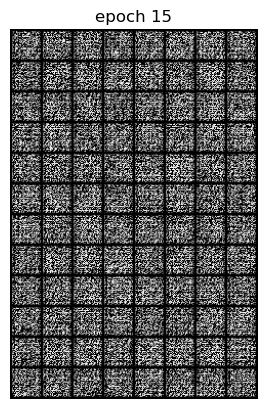

Epoch 15 of 100
Generator loss: 0.00153556, Discriminator loss: 0.00288996


469it [00:19, 23.70it/s]                         


Epoch 16 of 100
Generator loss: 0.00153505, Discriminator loss: 0.00292611


469it [00:21, 22.10it/s]                         


Epoch 17 of 100
Generator loss: 0.00146229, Discriminator loss: 0.00295547


469it [00:20, 22.88it/s]                         


Epoch 18 of 100
Generator loss: 0.00144728, Discriminator loss: 0.00302836


469it [00:20, 22.51it/s]                         


Epoch 19 of 100
Generator loss: 0.00148121, Discriminator loss: 0.00291486


469it [00:19, 23.73it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


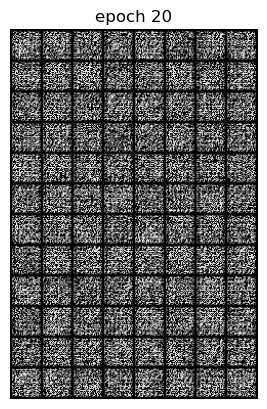

Epoch 20 of 100
Generator loss: 0.00153515, Discriminator loss: 0.00288957


469it [00:19, 24.39it/s]                         


Epoch 21 of 100
Generator loss: 0.00152541, Discriminator loss: 0.00295094


469it [00:19, 23.74it/s]                         


Epoch 22 of 100
Generator loss: 0.00150838, Discriminator loss: 0.00296715


469it [00:20, 23.19it/s]                         


Epoch 23 of 100
Generator loss: 0.00141751, Discriminator loss: 0.00301678


469it [00:20, 22.52it/s]                         


Epoch 24 of 100
Generator loss: 0.00150411, Discriminator loss: 0.00292691


469it [00:20, 22.50it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


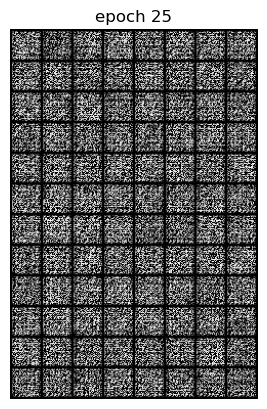

Epoch 25 of 100
Generator loss: 0.00141255, Discriminator loss: 0.00308045


469it [00:21, 22.00it/s]                         


Epoch 26 of 100
Generator loss: 0.00145256, Discriminator loss: 0.00299802


469it [00:20, 22.42it/s]                         


Epoch 27 of 100
Generator loss: 0.00150616, Discriminator loss: 0.00300446


469it [00:21, 22.17it/s]                         


Epoch 28 of 100
Generator loss: 0.00153996, Discriminator loss: 0.00289306


469it [00:20, 22.79it/s]                         


Epoch 29 of 100
Generator loss: 0.00150591, Discriminator loss: 0.00290064


469it [00:20, 22.62it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


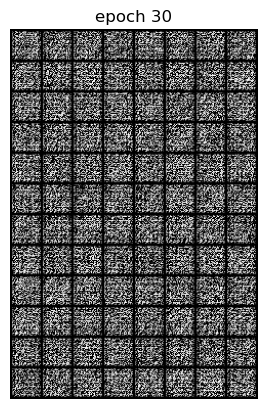

Epoch 30 of 100
Generator loss: 0.00152070, Discriminator loss: 0.00291556


469it [00:21, 22.30it/s]                         


Epoch 31 of 100
Generator loss: 0.00148411, Discriminator loss: 0.00296331


469it [00:21, 21.88it/s]                         


Epoch 32 of 100
Generator loss: 0.00152228, Discriminator loss: 0.00297565


469it [00:21, 22.22it/s]                         


Epoch 33 of 100
Generator loss: 0.00147518, Discriminator loss: 0.00296529


469it [00:20, 22.55it/s]                         


Epoch 34 of 100
Generator loss: 0.00145700, Discriminator loss: 0.00299126


469it [00:20, 22.78it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


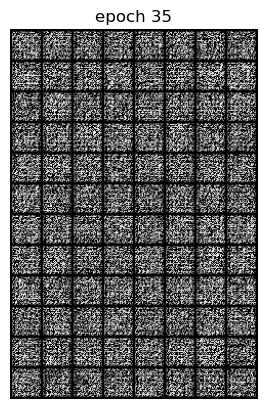

Epoch 35 of 100
Generator loss: 0.00145561, Discriminator loss: 0.00299107


469it [00:21, 22.32it/s]                         


Epoch 36 of 100
Generator loss: 0.00147602, Discriminator loss: 0.00298650


469it [00:22, 21.30it/s]                         


Epoch 37 of 100
Generator loss: 0.00145738, Discriminator loss: 0.00298825


469it [00:20, 22.71it/s]                         


Epoch 38 of 100
Generator loss: 0.00146667, Discriminator loss: 0.00292802


469it [00:20, 22.77it/s]                         


Epoch 39 of 100
Generator loss: 0.00143405, Discriminator loss: 0.00304814


469it [00:20, 22.74it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


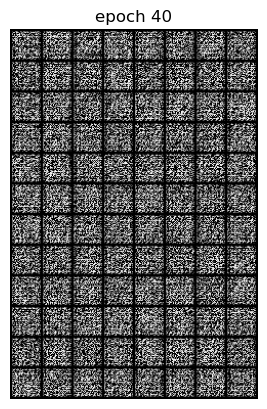

Epoch 40 of 100
Generator loss: 0.00147854, Discriminator loss: 0.00298626


469it [00:21, 22.05it/s]                         


Epoch 41 of 100
Generator loss: 0.00149369, Discriminator loss: 0.00296869


469it [00:20, 22.41it/s]                         


Epoch 42 of 100
Generator loss: 0.00146772, Discriminator loss: 0.00295631


469it [00:20, 22.77it/s]                         


Epoch 43 of 100
Generator loss: 0.00147575, Discriminator loss: 0.00299763


469it [00:20, 22.81it/s]                         


Epoch 44 of 100
Generator loss: 0.00153870, Discriminator loss: 0.00282126


469it [00:21, 22.33it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


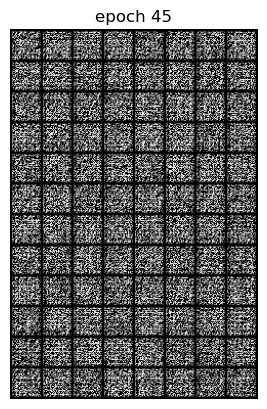

Epoch 45 of 100
Generator loss: 0.00148400, Discriminator loss: 0.00287118


469it [00:20, 23.11it/s]                         


Epoch 46 of 100
Generator loss: 0.00148314, Discriminator loss: 0.00296624


469it [00:19, 23.56it/s]                         


Epoch 47 of 100
Generator loss: 0.00148886, Discriminator loss: 0.00292209


469it [00:20, 22.78it/s]                         


Epoch 48 of 100
Generator loss: 0.00150227, Discriminator loss: 0.00292283


469it [00:20, 22.76it/s]                         


Epoch 49 of 100
Generator loss: 0.00150062, Discriminator loss: 0.00295627


469it [00:20, 23.27it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


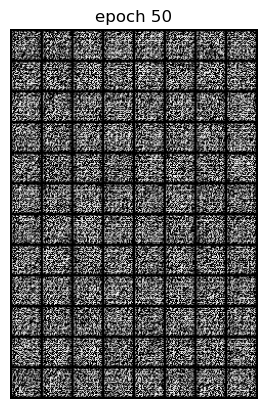

Epoch 50 of 100
Generator loss: 0.00150806, Discriminator loss: 0.00291176


469it [00:20, 23.16it/s]                         


Epoch 51 of 100
Generator loss: 0.00149742, Discriminator loss: 0.00290422


469it [00:21, 21.92it/s]                         


Epoch 52 of 100
Generator loss: 0.00148607, Discriminator loss: 0.00295017


469it [00:20, 22.85it/s]                         


Epoch 53 of 100
Generator loss: 0.00144679, Discriminator loss: 0.00301045


469it [00:20, 22.59it/s]                         


Epoch 54 of 100
Generator loss: 0.00143305, Discriminator loss: 0.00297426


469it [00:20, 22.49it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


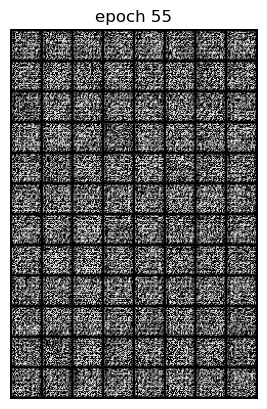

Epoch 55 of 100
Generator loss: 0.00148538, Discriminator loss: 0.00297730


469it [00:21, 22.26it/s]                         


Epoch 56 of 100
Generator loss: 0.00151686, Discriminator loss: 0.00294207


469it [00:22, 21.30it/s]                         


Epoch 57 of 100
Generator loss: 0.00150635, Discriminator loss: 0.00293419


469it [00:20, 22.54it/s]                         


Epoch 58 of 100
Generator loss: 0.00157459, Discriminator loss: 0.00289539


469it [00:19, 23.49it/s]                         


Epoch 59 of 100
Generator loss: 0.00152634, Discriminator loss: 0.00290106


469it [00:20, 23.32it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


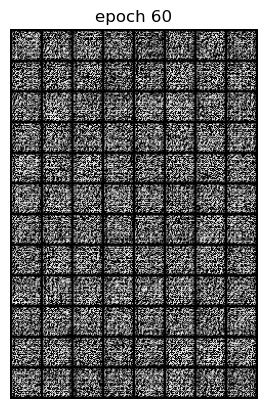

Epoch 60 of 100
Generator loss: 0.00144274, Discriminator loss: 0.00300831


469it [00:19, 23.47it/s]                         


Epoch 61 of 100
Generator loss: 0.00149983, Discriminator loss: 0.00297582


469it [00:20, 22.48it/s]                         


Epoch 62 of 100
Generator loss: 0.00146671, Discriminator loss: 0.00297925


469it [00:20, 22.55it/s]                         


Epoch 63 of 100
Generator loss: 0.00153025, Discriminator loss: 0.00292127


469it [00:20, 22.38it/s]                         


Epoch 64 of 100
Generator loss: 0.00156810, Discriminator loss: 0.00296206


469it [00:20, 22.63it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


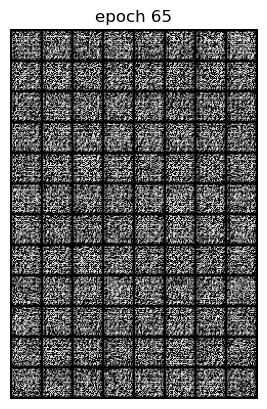

Epoch 65 of 100
Generator loss: 0.00150237, Discriminator loss: 0.00297479


469it [00:21, 22.24it/s]                         


Epoch 66 of 100
Generator loss: 0.00144234, Discriminator loss: 0.00296555


469it [00:20, 22.34it/s]                         


Epoch 67 of 100
Generator loss: 0.00150790, Discriminator loss: 0.00296628


469it [00:20, 22.88it/s]                         


Epoch 68 of 100
Generator loss: 0.00147532, Discriminator loss: 0.00289075


469it [00:21, 22.26it/s]                         


Epoch 69 of 100
Generator loss: 0.00150869, Discriminator loss: 0.00290539


469it [00:20, 22.79it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


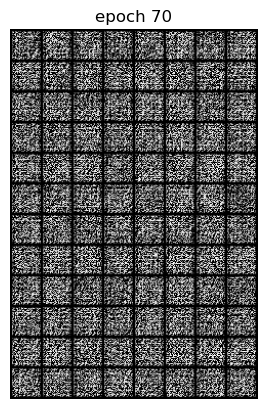

Epoch 70 of 100
Generator loss: 0.00143366, Discriminator loss: 0.00300121


469it [00:20, 22.69it/s]                         


Epoch 71 of 100
Generator loss: 0.00148457, Discriminator loss: 0.00292356


469it [00:21, 22.22it/s]                         


Epoch 72 of 100
Generator loss: 0.00152129, Discriminator loss: 0.00295049


469it [00:20, 22.67it/s]                         


Epoch 73 of 100
Generator loss: 0.00153469, Discriminator loss: 0.00285865


469it [00:21, 21.93it/s]                         


Epoch 74 of 100
Generator loss: 0.00150790, Discriminator loss: 0.00299547


469it [00:20, 23.05it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


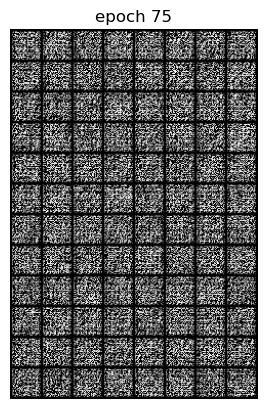

Epoch 75 of 100
Generator loss: 0.00152848, Discriminator loss: 0.00294613


469it [00:20, 22.87it/s]                         


Epoch 76 of 100
Generator loss: 0.00152370, Discriminator loss: 0.00289465


469it [00:20, 23.26it/s]                         


Epoch 77 of 100
Generator loss: 0.00149411, Discriminator loss: 0.00294838


469it [00:21, 21.91it/s]                         


Epoch 78 of 100
Generator loss: 0.00147274, Discriminator loss: 0.00302030


469it [00:20, 22.35it/s]                         


Epoch 79 of 100
Generator loss: 0.00148492, Discriminator loss: 0.00291892


469it [00:20, 22.68it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


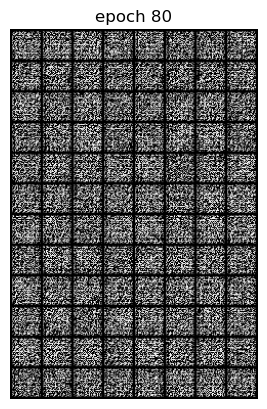

Epoch 80 of 100
Generator loss: 0.00146569, Discriminator loss: 0.00304803


469it [00:21, 21.46it/s]                         


Epoch 81 of 100
Generator loss: 0.00151810, Discriminator loss: 0.00292872


469it [00:21, 22.33it/s]                         


Epoch 82 of 100
Generator loss: 0.00149520, Discriminator loss: 0.00298280


469it [00:20, 22.46it/s]                         


Epoch 83 of 100
Generator loss: 0.00148596, Discriminator loss: 0.00293774


469it [00:20, 22.61it/s]                         


Epoch 84 of 100
Generator loss: 0.00149595, Discriminator loss: 0.00294968


469it [00:20, 22.62it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


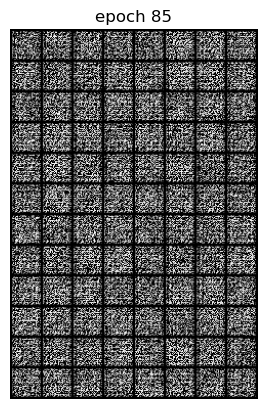

Epoch 85 of 100
Generator loss: 0.00142563, Discriminator loss: 0.00303043


469it [00:20, 22.54it/s]                         


Epoch 86 of 100
Generator loss: 0.00145833, Discriminator loss: 0.00297280


469it [00:20, 22.90it/s]                         


Epoch 87 of 100
Generator loss: 0.00149414, Discriminator loss: 0.00294224


469it [00:20, 22.68it/s]                         


Epoch 88 of 100
Generator loss: 0.00151463, Discriminator loss: 0.00290481


469it [00:20, 23.38it/s]                         


Epoch 89 of 100
Generator loss: 0.00144848, Discriminator loss: 0.00295409


469it [00:19, 23.77it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


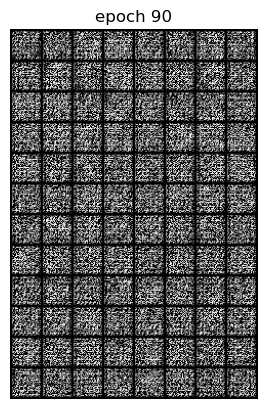

Epoch 90 of 100
Generator loss: 0.00153548, Discriminator loss: 0.00292719


469it [00:19, 23.65it/s]                         


Epoch 91 of 100
Generator loss: 0.00147845, Discriminator loss: 0.00299741


469it [00:19, 23.65it/s]                         


Epoch 92 of 100
Generator loss: 0.00151186, Discriminator loss: 0.00294935


469it [00:19, 23.54it/s]                         


Epoch 93 of 100
Generator loss: 0.00149616, Discriminator loss: 0.00295102


469it [00:19, 23.56it/s]                         


Epoch 94 of 100
Generator loss: 0.00147045, Discriminator loss: 0.00296765


469it [00:19, 23.78it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


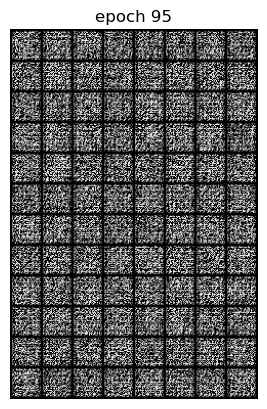

Epoch 95 of 100
Generator loss: 0.00153190, Discriminator loss: 0.00295915


469it [00:27, 17.07it/s]                         


Epoch 96 of 100
Generator loss: 0.00158806, Discriminator loss: 0.00279628


469it [00:29, 15.96it/s]                         


Epoch 97 of 100
Generator loss: 0.00146755, Discriminator loss: 0.00297779


469it [00:29, 15.65it/s]                         


Epoch 98 of 100
Generator loss: 0.00155477, Discriminator loss: 0.00294698


469it [00:29, 15.99it/s]                         


Epoch 99 of 100
Generator loss: 0.00146106, Discriminator loss: 0.00297797


469it [00:29, 16.01it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


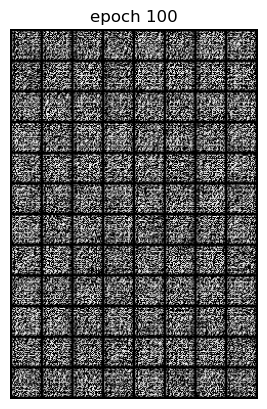

Epoch 100 of 100
Generator loss: 0.00149513, Discriminator loss: 0.00298345


In [84]:
torch.manual_seed(7777)

def generator_loss(output, true_label):
    ############ YOUR CODE HERE ##########
    return criterion(output, true_label)
    
    
    ######################################
    
def discriminator_loss(output, true_label):
    ############ YOUR CODE HERE ##########
    return criterion(output, true_label)
    
    
    ######################################

epochs = 100

for epoch in range(epochs):
    loss_g = 0.0
    loss_d = 0.0
    for bi, data in tqdm(enumerate(train_loader), total=int(len(train_data)/train_loader.batch_size)):
        ############ YOUR CODE HERE ########## 
        real_images, _ = data
        real_images = real_images.to(device)
        batch_size = real_images.size(0)
        noise = create_noise_DCGAN(batch_size, nz)
        fake_sample = generator(noise)
        disc_r_samp = discriminator(real_images).view(-1)
        lossD_realSample = criterion(disc_r_samp, label_real(disc_r_samp.size()))
        disc_f_samp = discriminator(fake_sample).view(-1)
        lossD_fakeSample = criterion(disc_f_samp, label_fake(disc_f_samp.size())) 
        loss_d = (lossD_realSample + lossD_fakeSample)
        discriminator.zero_grad()
        loss_d.backward(retain_graph=True)
        optim_d.step()
        
        lossD_fakeSample = discriminator(fake_sample).view(-1)
        loss_g = criterion(lossD_fakeSample, label_real(lossD_fakeSample.size()))        
        generator.zero_grad()
        loss_g.backward(retain_graph=True)
        optim_g.step()
        
        ######################################
    
    
    # create the final fake image for the epoch
    generated_img = generator(noise).cpu().detach()
    
    # make the images as grid
    generated_img = make_grid(generated_img)
    
    # visualize generated images
    if (epoch + 1) % 5 == 0:
        plt.imshow(generated_img.permute(1, 2, 0))
        plt.title(f'epoch {epoch+1}')
        plt.axis('off')
        plt.show()
    
    # save the generated torch tensor models to disk
    save_generator_image(generated_img, f"outputs_c/gen_img{epoch+1}.png")
    images.append(generated_img)
    epoch_loss_g = loss_g / bi # total generator loss for the epoch
    epoch_loss_d = loss_d / bi # total discriminator loss for the epoch
    losses_g.append(epoch_loss_g)
    losses_d.append(epoch_loss_d)
    
    print(f"Epoch {epoch+1} of {epochs}")
    print(f"Generator loss: {epoch_loss_g:.8f}, Discriminator loss: {epoch_loss_d:.8f}")

In [85]:
print('DONE TRAINING')
torch.save(generator.state_dict(), 'outputs_c/generator.pth')

DONE TRAINING


In [86]:
# save the generated images as GIF file
imgs = [np.array(to_pil_image(img)) for img in images]
imageio.mimsave('outputs_c/generator_images.gif', imgs)

In [89]:
losses_g_up = [a.cpu().detach().numpy() if a!=0 else a for a in losses_g]
losses_d_up = [a.cpu().detach().numpy() if a!=0 else a for a in losses_d]

In [90]:
losses_g_with_updates = losses_g
losses_d_with_updates = losses_d


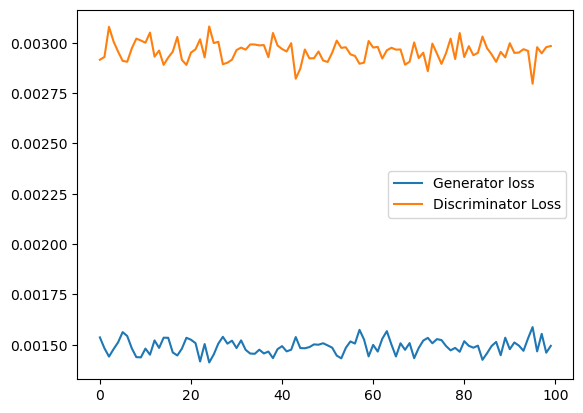

In [91]:
# plot and save the generator and discriminator loss
plt.figure()
plt.plot(losses_g_up, label='Generator loss')
plt.plot(losses_d_up, label='Discriminator Loss')
plt.legend()
plt.savefig('outputs_d/loss.png')

In [103]:
class Generator(nn.Module):
    def __init__(self, nz):
        super(Generator, self).__init__()
        self.nz = nz
        self.main = nn.Sequential(
            nn.Linear(self.nz, 256),
            nn.LeakyReLU(0.2),
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2),
            nn.Linear(512, 1024),
            nn.LeakyReLU(0.2),
            nn.Linear(1024, 784),
            nn.Tanh(),
        )
    def forward(self, x):
        return self.main(x).view(-1, 1, 28, 28)

In [104]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.n_input = 784
        self.main = nn.Sequential(
            nn.Linear(self.n_input, 1024),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3),
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3),
            nn.Linear(256, 1),
            nn.Sigmoid(),
        )
    def forward(self, x):
        x = x.view(-1, 784)
        return self.main(x)

In [112]:
train_loader = DataLoader(train_data, batch_size=256, shuffle=True)

In [113]:
generator = Generator(nz).to(device)
discriminator = Discriminator().to(device)
print('##### GENERATOR #####')
print(generator)
print('######################')
print('\n##### DISCRIMINATOR #####')
print(discriminator)
print('######################')

##### GENERATOR #####
Generator(
  (main): Sequential(
    (0): Linear(in_features=128, out_features=256, bias=True)
    (1): LeakyReLU(negative_slope=0.2)
    (2): Linear(in_features=256, out_features=512, bias=True)
    (3): LeakyReLU(negative_slope=0.2)
    (4): Linear(in_features=512, out_features=1024, bias=True)
    (5): LeakyReLU(negative_slope=0.2)
    (6): Linear(in_features=1024, out_features=784, bias=True)
    (7): Tanh()
  )
)
######################

##### DISCRIMINATOR #####
Discriminator(
  (main): Sequential(
    (0): Linear(in_features=784, out_features=1024, bias=True)
    (1): LeakyReLU(negative_slope=0.2)
    (2): Dropout(p=0.3, inplace=False)
    (3): Linear(in_features=1024, out_features=512, bias=True)
    (4): LeakyReLU(negative_slope=0.2)
    (5): Dropout(p=0.3, inplace=False)
    (6): Linear(in_features=512, out_features=256, bias=True)
    (7): LeakyReLU(negative_slope=0.2)
    (8): Dropout(p=0.3, inplace=False)
    (9): Linear(in_features=256, out_features=1

In [114]:
# optimizers
optim_g = optim.Adam(generator.parameters(), lr=0.0002)
optim_d = optim.Adam(discriminator.parameters(), lr=0.0002)

In [115]:
# loss function
criterion = nn.BCELoss() # Binary Cross Entropy loss

In [116]:
losses_g = [] # to store generator loss after each epoch
losses_d = [] # to store discriminator loss after each epoch
images = [] # to store images generatd by the generator

In [117]:
device='mps'

mkdir: outputs_d: File exists


235it [00:12, 18.80it/s]                         


Epoch 1 of 150
Generator loss: 0.02956959, Discriminator loss: 0.00013844


235it [00:11, 20.40it/s]                         


Epoch 2 of 150
Generator loss: 0.00176182, Discriminator loss: 0.00278835


235it [00:11, 20.22it/s]                         


Epoch 3 of 150
Generator loss: 0.01537972, Discriminator loss: 0.00066478


235it [00:11, 20.38it/s]                         


Epoch 4 of 150
Generator loss: 0.00111825, Discriminator loss: 0.00317809


235it [00:11, 20.66it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


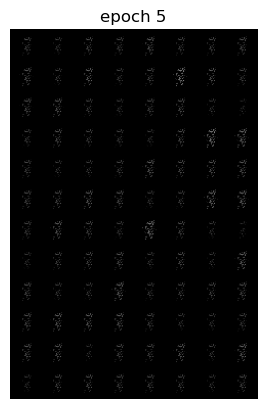

Epoch 5 of 150
Generator loss: 0.00411884, Discriminator loss: 0.00153168


235it [00:11, 20.05it/s]                         


Epoch 6 of 150
Generator loss: 0.00494958, Discriminator loss: 0.00237553


235it [00:11, 20.19it/s]                         


Epoch 7 of 150
Generator loss: 0.00820625, Discriminator loss: 0.00073377


235it [00:11, 20.17it/s]                         


Epoch 8 of 150
Generator loss: 0.00949943, Discriminator loss: 0.00092090


235it [00:12, 18.96it/s]                         


Epoch 9 of 150
Generator loss: 0.00926717, Discriminator loss: 0.00061482


235it [00:11, 19.89it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


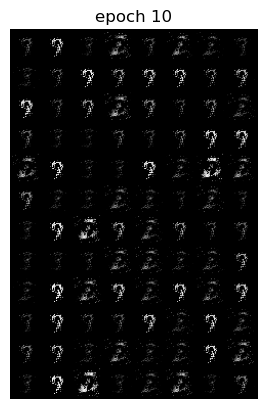

Epoch 10 of 150
Generator loss: 0.01181915, Discriminator loss: 0.00043905


235it [00:11, 20.10it/s]                         


Epoch 11 of 150
Generator loss: 0.01112652, Discriminator loss: 0.00067522


235it [00:11, 20.45it/s]                         


Epoch 12 of 150
Generator loss: 0.00811509, Discriminator loss: 0.00115699


235it [00:12, 19.23it/s]                         


Epoch 13 of 150
Generator loss: 0.01103564, Discriminator loss: 0.00078918


235it [00:11, 20.18it/s]                         


Epoch 14 of 150
Generator loss: 0.01139385, Discriminator loss: 0.00141125


235it [00:11, 20.84it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


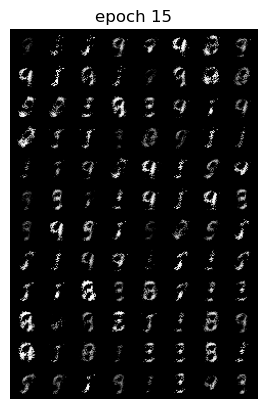

Epoch 15 of 150
Generator loss: 0.01153494, Discriminator loss: 0.00052852


235it [00:11, 20.63it/s]                         


Epoch 16 of 150
Generator loss: 0.01272091, Discriminator loss: 0.00055468


235it [00:11, 20.62it/s]                         


Epoch 17 of 150
Generator loss: 0.01148922, Discriminator loss: 0.00052133


235it [00:11, 20.65it/s]                         


Epoch 18 of 150
Generator loss: 0.01042778, Discriminator loss: 0.00095881


235it [00:11, 20.92it/s]                         


Epoch 19 of 150
Generator loss: 0.00840005, Discriminator loss: 0.00107208


235it [00:11, 21.09it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


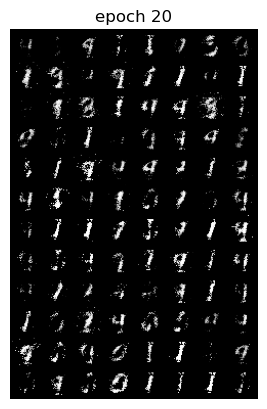

Epoch 20 of 150
Generator loss: 0.01119689, Discriminator loss: 0.00065677


235it [00:10, 21.98it/s]                         


Epoch 21 of 150
Generator loss: 0.00872682, Discriminator loss: 0.00110873


235it [00:10, 22.03it/s]                         


Epoch 22 of 150
Generator loss: 0.01164150, Discriminator loss: 0.00078015


235it [00:11, 20.81it/s]                         


Epoch 23 of 150
Generator loss: 0.00965179, Discriminator loss: 0.00088027


235it [00:10, 21.70it/s]                         


Epoch 24 of 150
Generator loss: 0.00976308, Discriminator loss: 0.00140932


235it [00:10, 22.05it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


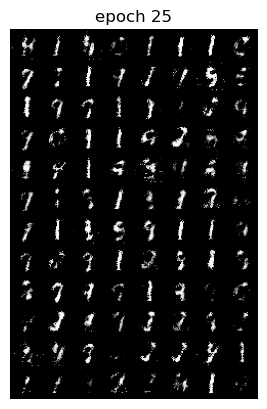

Epoch 25 of 150
Generator loss: 0.00622408, Discriminator loss: 0.00119738


235it [00:10, 21.89it/s]                         


Epoch 26 of 150
Generator loss: 0.00777006, Discriminator loss: 0.00105698


235it [00:10, 22.01it/s]                         


Epoch 27 of 150
Generator loss: 0.00707721, Discriminator loss: 0.00138698


235it [00:10, 21.90it/s]                         


Epoch 28 of 150
Generator loss: 0.00721275, Discriminator loss: 0.00140677


235it [00:10, 22.03it/s]                         


Epoch 29 of 150
Generator loss: 0.00696483, Discriminator loss: 0.00114595


235it [00:10, 21.85it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


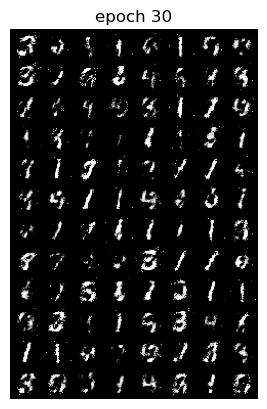

Epoch 30 of 150
Generator loss: 0.00582901, Discriminator loss: 0.00145075


235it [00:11, 20.85it/s]                         


Epoch 31 of 150
Generator loss: 0.00704411, Discriminator loss: 0.00142149


235it [00:11, 21.29it/s]                         


Epoch 32 of 150
Generator loss: 0.00760196, Discriminator loss: 0.00149832


235it [00:10, 21.81it/s]                         


Epoch 33 of 150
Generator loss: 0.00521724, Discriminator loss: 0.00110775


235it [00:10, 21.88it/s]                         


Epoch 34 of 150
Generator loss: 0.00756933, Discriminator loss: 0.00098605


235it [00:10, 22.04it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


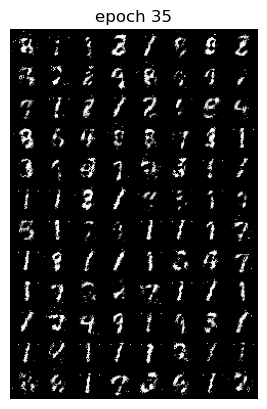

Epoch 35 of 150
Generator loss: 0.00706690, Discriminator loss: 0.00117625


235it [00:10, 22.03it/s]                         


Epoch 36 of 150
Generator loss: 0.00622161, Discriminator loss: 0.00138624


235it [00:10, 22.12it/s]                         


Epoch 37 of 150
Generator loss: 0.00527993, Discriminator loss: 0.00139467


235it [00:10, 21.96it/s]                         


Epoch 38 of 150
Generator loss: 0.00722274, Discriminator loss: 0.00122851


235it [00:10, 22.09it/s]                         


Epoch 39 of 150
Generator loss: 0.00649458, Discriminator loss: 0.00150278


235it [00:10, 21.87it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


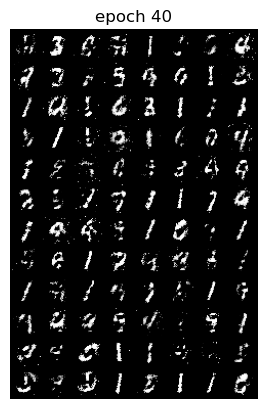

Epoch 40 of 150
Generator loss: 0.00545711, Discriminator loss: 0.00130463


235it [00:10, 22.02it/s]                         


Epoch 41 of 150
Generator loss: 0.00603099, Discriminator loss: 0.00159837


235it [00:10, 21.83it/s]                         


Epoch 42 of 150
Generator loss: 0.00716843, Discriminator loss: 0.00126334


235it [00:10, 21.55it/s]                         


Epoch 43 of 150
Generator loss: 0.00528931, Discriminator loss: 0.00208091


235it [00:10, 21.55it/s]                         


Epoch 44 of 150
Generator loss: 0.00566268, Discriminator loss: 0.00145947


235it [00:10, 22.08it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


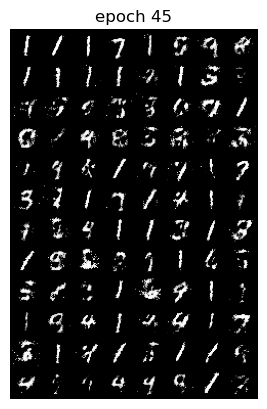

Epoch 45 of 150
Generator loss: 0.00531641, Discriminator loss: 0.00150278


235it [00:10, 21.80it/s]                         


Epoch 46 of 150
Generator loss: 0.00518247, Discriminator loss: 0.00170545


235it [00:10, 21.85it/s]                         


Epoch 47 of 150
Generator loss: 0.00461072, Discriminator loss: 0.00170437


235it [00:10, 21.99it/s]                         


Epoch 48 of 150
Generator loss: 0.00579147, Discriminator loss: 0.00129793


235it [00:10, 21.83it/s]                         


Epoch 49 of 150
Generator loss: 0.00437013, Discriminator loss: 0.00156443


235it [00:11, 21.15it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


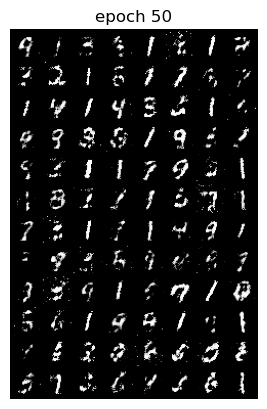

Epoch 50 of 150
Generator loss: 0.00479885, Discriminator loss: 0.00132742


235it [00:11, 21.36it/s]                         


Epoch 51 of 150
Generator loss: 0.00472996, Discriminator loss: 0.00171987


235it [00:10, 21.72it/s]                         


Epoch 52 of 150
Generator loss: 0.00515898, Discriminator loss: 0.00160627


235it [00:10, 21.40it/s]                         


Epoch 53 of 150
Generator loss: 0.00479411, Discriminator loss: 0.00165572


235it [00:12, 19.13it/s]                         


Epoch 54 of 150
Generator loss: 0.00560580, Discriminator loss: 0.00130222


235it [00:12, 18.17it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


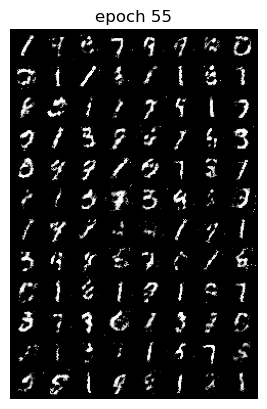

Epoch 55 of 150
Generator loss: 0.00509883, Discriminator loss: 0.00160013


235it [00:11, 20.80it/s]                         


Epoch 56 of 150
Generator loss: 0.00565128, Discriminator loss: 0.00128013


235it [00:11, 21.01it/s]                         


Epoch 57 of 150
Generator loss: 0.00380545, Discriminator loss: 0.00190949


235it [00:11, 19.73it/s]                         


Epoch 58 of 150
Generator loss: 0.00601054, Discriminator loss: 0.00172860


235it [00:12, 18.79it/s]                         


Epoch 59 of 150
Generator loss: 0.00511989, Discriminator loss: 0.00182873


235it [00:12, 19.31it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


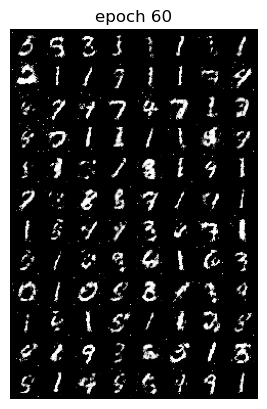

Epoch 60 of 150
Generator loss: 0.00534372, Discriminator loss: 0.00166903


235it [00:11, 19.80it/s]                         


Epoch 61 of 150
Generator loss: 0.00529194, Discriminator loss: 0.00173943


235it [00:11, 20.43it/s]                         


Epoch 62 of 150
Generator loss: 0.00509505, Discriminator loss: 0.00173611


235it [00:11, 20.29it/s]                         


Epoch 63 of 150
Generator loss: 0.00446192, Discriminator loss: 0.00182648


235it [00:11, 19.67it/s]                         


Epoch 64 of 150
Generator loss: 0.00343480, Discriminator loss: 0.00199080


235it [00:12, 19.03it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


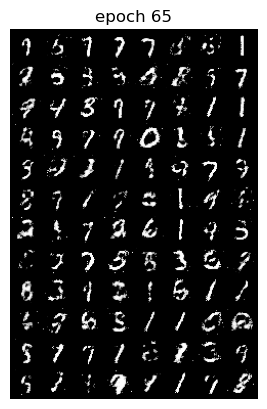

Epoch 65 of 150
Generator loss: 0.00461836, Discriminator loss: 0.00157315


235it [00:11, 20.59it/s]                         


Epoch 66 of 150
Generator loss: 0.00542947, Discriminator loss: 0.00163590


235it [00:11, 19.73it/s]                         


Epoch 67 of 150
Generator loss: 0.00426984, Discriminator loss: 0.00207993


235it [00:11, 20.43it/s]                         


Epoch 68 of 150
Generator loss: 0.00465387, Discriminator loss: 0.00197992


235it [00:11, 20.08it/s]                         


Epoch 69 of 150
Generator loss: 0.00403514, Discriminator loss: 0.00164932


235it [00:11, 21.15it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


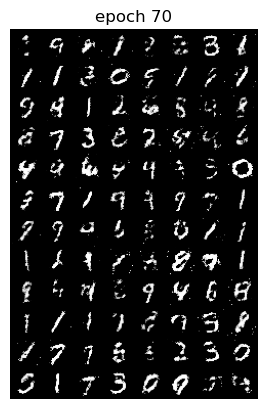

Epoch 70 of 150
Generator loss: 0.00422635, Discriminator loss: 0.00170571


235it [00:11, 20.44it/s]                         


Epoch 71 of 150
Generator loss: 0.00356395, Discriminator loss: 0.00198801


235it [00:11, 19.80it/s]                         


Epoch 72 of 150
Generator loss: 0.00396436, Discriminator loss: 0.00189028


235it [00:12, 19.45it/s]                         


Epoch 73 of 150
Generator loss: 0.00532354, Discriminator loss: 0.00155874


235it [00:11, 20.98it/s]                         


Epoch 74 of 150
Generator loss: 0.00443361, Discriminator loss: 0.00199836


235it [00:11, 20.46it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


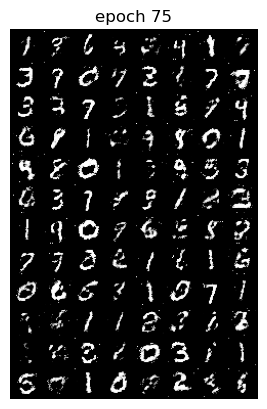

Epoch 75 of 150
Generator loss: 0.00531010, Discriminator loss: 0.00174233


235it [00:11, 20.23it/s]                         


Epoch 76 of 150
Generator loss: 0.00514671, Discriminator loss: 0.00162726


235it [00:11, 20.74it/s]                         


Epoch 77 of 150
Generator loss: 0.00425693, Discriminator loss: 0.00175008


235it [00:11, 20.75it/s]                         


Epoch 78 of 150
Generator loss: 0.00353353, Discriminator loss: 0.00188494


235it [00:11, 20.47it/s]                         


Epoch 79 of 150
Generator loss: 0.00310006, Discriminator loss: 0.00200203


235it [00:11, 20.40it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


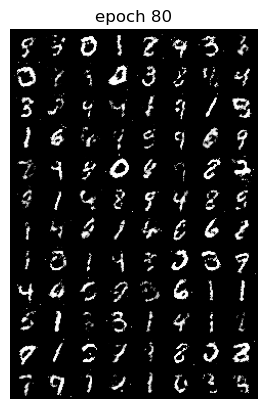

Epoch 80 of 150
Generator loss: 0.00238633, Discriminator loss: 0.00205270


235it [00:11, 20.22it/s]                         


Epoch 81 of 150
Generator loss: 0.00342070, Discriminator loss: 0.00188424


235it [00:11, 20.43it/s]                         


Epoch 82 of 150
Generator loss: 0.00251684, Discriminator loss: 0.00212731


235it [00:11, 20.70it/s]                         


Epoch 83 of 150
Generator loss: 0.00423318, Discriminator loss: 0.00189977


235it [00:11, 20.71it/s]                         


Epoch 84 of 150
Generator loss: 0.00372197, Discriminator loss: 0.00192613


235it [00:11, 20.43it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


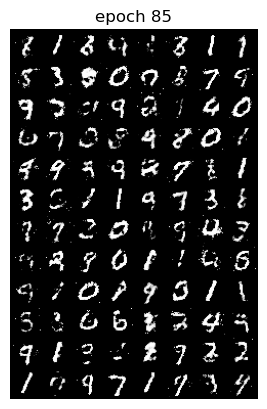

Epoch 85 of 150
Generator loss: 0.00414433, Discriminator loss: 0.00188801


235it [00:11, 20.35it/s]                         


Epoch 86 of 150
Generator loss: 0.00375848, Discriminator loss: 0.00199339


235it [00:11, 20.77it/s]                         


Epoch 87 of 150
Generator loss: 0.00438260, Discriminator loss: 0.00175083


235it [00:11, 21.13it/s]                         


Epoch 88 of 150
Generator loss: 0.00296390, Discriminator loss: 0.00191791


235it [00:11, 19.97it/s]                         


Epoch 89 of 150
Generator loss: 0.00394625, Discriminator loss: 0.00199736


235it [00:12, 19.42it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


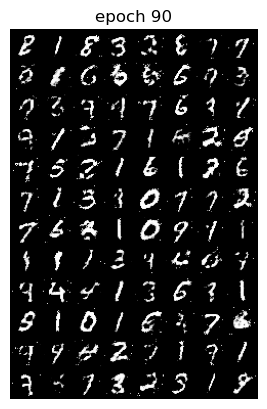

Epoch 90 of 150
Generator loss: 0.00423625, Discriminator loss: 0.00182643


235it [00:12, 19.19it/s]                         


Epoch 91 of 150
Generator loss: 0.00317939, Discriminator loss: 0.00215095


235it [00:11, 19.91it/s]                         


Epoch 92 of 150
Generator loss: 0.00270304, Discriminator loss: 0.00204421


235it [00:11, 20.56it/s]                         


Epoch 93 of 150
Generator loss: 0.00329214, Discriminator loss: 0.00209657


235it [00:11, 20.26it/s]                         


Epoch 94 of 150
Generator loss: 0.00370015, Discriminator loss: 0.00207853


235it [00:11, 21.31it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


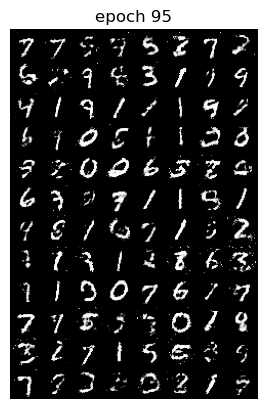

Epoch 95 of 150
Generator loss: 0.00345117, Discriminator loss: 0.00207622


235it [00:11, 21.13it/s]                         


Epoch 96 of 150
Generator loss: 0.00350235, Discriminator loss: 0.00181238


235it [00:10, 21.61it/s]                         


Epoch 97 of 150
Generator loss: 0.00261997, Discriminator loss: 0.00203218


235it [00:10, 21.74it/s]                         


Epoch 98 of 150
Generator loss: 0.00328306, Discriminator loss: 0.00208211


235it [00:10, 21.67it/s]                         


Epoch 99 of 150
Generator loss: 0.00341305, Discriminator loss: 0.00193897


235it [00:10, 21.58it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


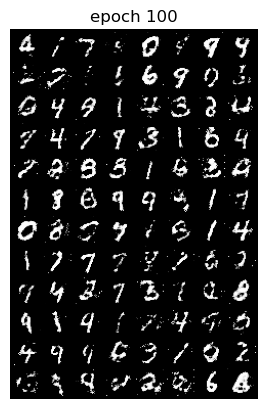

Epoch 100 of 150
Generator loss: 0.00287261, Discriminator loss: 0.00183900


235it [00:10, 21.67it/s]                         


Epoch 101 of 150
Generator loss: 0.00364058, Discriminator loss: 0.00198520


235it [00:10, 21.38it/s]                         


Epoch 102 of 150
Generator loss: 0.00378583, Discriminator loss: 0.00198612


235it [00:10, 21.67it/s]                         


Epoch 103 of 150
Generator loss: 0.00283743, Discriminator loss: 0.00234885


235it [00:10, 21.64it/s]                         


Epoch 104 of 150
Generator loss: 0.00322633, Discriminator loss: 0.00219686


235it [00:11, 21.09it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


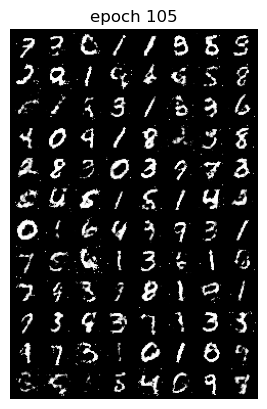

Epoch 105 of 150
Generator loss: 0.00347185, Discriminator loss: 0.00195171


235it [00:10, 21.56it/s]                         


Epoch 106 of 150
Generator loss: 0.00281871, Discriminator loss: 0.00232706


235it [00:11, 21.36it/s]                         


Epoch 107 of 150
Generator loss: 0.00369558, Discriminator loss: 0.00186933


235it [00:11, 20.38it/s]                         


Epoch 108 of 150
Generator loss: 0.00282432, Discriminator loss: 0.00221394


235it [00:11, 20.77it/s]                         


Epoch 109 of 150
Generator loss: 0.00361733, Discriminator loss: 0.00209016


235it [00:11, 20.73it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


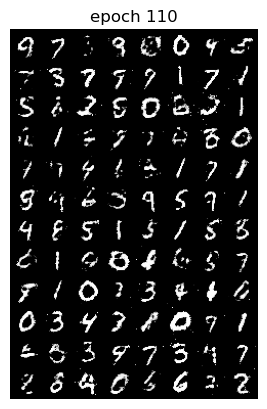

Epoch 110 of 150
Generator loss: 0.00291589, Discriminator loss: 0.00214247


235it [00:11, 20.50it/s]                         


Epoch 111 of 150
Generator loss: 0.00330858, Discriminator loss: 0.00210754


235it [00:11, 20.75it/s]                         


Epoch 112 of 150
Generator loss: 0.00299887, Discriminator loss: 0.00251360


235it [00:11, 20.68it/s]                         


Epoch 113 of 150
Generator loss: 0.00305984, Discriminator loss: 0.00207159


235it [00:11, 20.65it/s]                         


Epoch 114 of 150
Generator loss: 0.00345638, Discriminator loss: 0.00191661


235it [00:11, 20.63it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


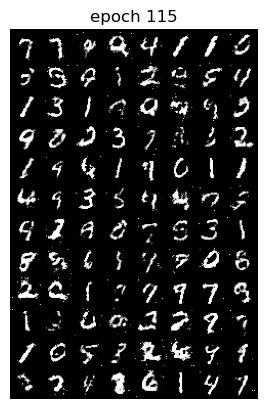

Epoch 115 of 150
Generator loss: 0.00257541, Discriminator loss: 0.00211241


235it [00:11, 20.59it/s]                         


Epoch 116 of 150
Generator loss: 0.00341135, Discriminator loss: 0.00208915


235it [00:11, 20.70it/s]                         


Epoch 117 of 150
Generator loss: 0.00308214, Discriminator loss: 0.00202039


235it [00:11, 20.68it/s]                         


Epoch 118 of 150
Generator loss: 0.00293387, Discriminator loss: 0.00226721


235it [00:11, 20.64it/s]                         


Epoch 119 of 150
Generator loss: 0.00340893, Discriminator loss: 0.00211093


235it [00:11, 20.65it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


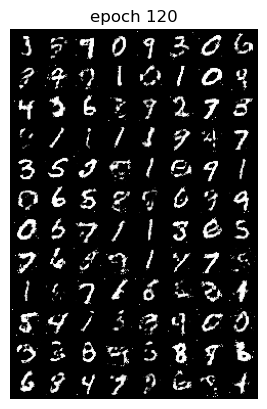

Epoch 120 of 150
Generator loss: 0.00315011, Discriminator loss: 0.00200369


235it [00:11, 20.58it/s]                         


Epoch 121 of 150
Generator loss: 0.00288840, Discriminator loss: 0.00202215


235it [00:11, 20.61it/s]                         


Epoch 122 of 150
Generator loss: 0.00338066, Discriminator loss: 0.00210088


235it [00:11, 20.56it/s]                         


Epoch 123 of 150
Generator loss: 0.00245721, Discriminator loss: 0.00231736


235it [00:11, 20.56it/s]                         


Epoch 124 of 150
Generator loss: 0.00341589, Discriminator loss: 0.00196196


235it [00:11, 20.57it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


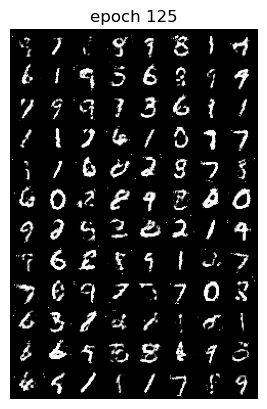

Epoch 125 of 150
Generator loss: 0.00259746, Discriminator loss: 0.00210304


235it [00:10, 21.63it/s]                         


Epoch 126 of 150
Generator loss: 0.00257822, Discriminator loss: 0.00209784


235it [00:10, 21.77it/s]                         


Epoch 127 of 150
Generator loss: 0.00236390, Discriminator loss: 0.00237467


235it [00:10, 21.69it/s]                         


Epoch 128 of 150
Generator loss: 0.00286472, Discriminator loss: 0.00224585


235it [00:10, 21.84it/s]                         


Epoch 129 of 150
Generator loss: 0.00342771, Discriminator loss: 0.00211071


235it [00:10, 21.58it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


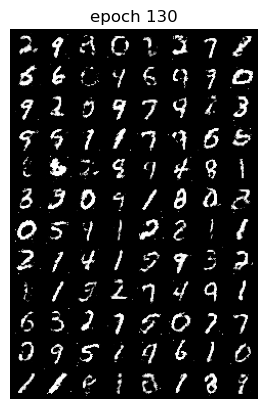

Epoch 130 of 150
Generator loss: 0.00344912, Discriminator loss: 0.00205402


235it [00:10, 21.81it/s]                         


Epoch 131 of 150
Generator loss: 0.00288659, Discriminator loss: 0.00220792


235it [00:10, 21.66it/s]                         


Epoch 132 of 150
Generator loss: 0.00362079, Discriminator loss: 0.00201099


235it [00:10, 21.73it/s]                         


Epoch 133 of 150
Generator loss: 0.00264586, Discriminator loss: 0.00213646


235it [00:10, 21.64it/s]                         


Epoch 134 of 150
Generator loss: 0.00246724, Discriminator loss: 0.00216531


235it [00:10, 21.74it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


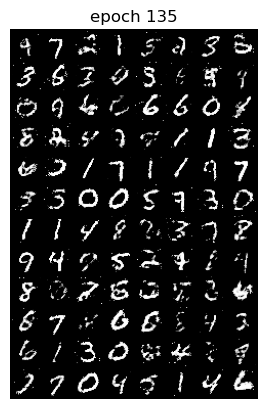

Epoch 135 of 150
Generator loss: 0.00294404, Discriminator loss: 0.00222056


235it [00:10, 21.74it/s]                         


Epoch 136 of 150
Generator loss: 0.00293360, Discriminator loss: 0.00195442


235it [00:10, 21.73it/s]                         


Epoch 137 of 150
Generator loss: 0.00329176, Discriminator loss: 0.00215813


235it [00:10, 21.86it/s]                         


Epoch 138 of 150
Generator loss: 0.00267993, Discriminator loss: 0.00233228


235it [00:10, 21.65it/s]                         


Epoch 139 of 150
Generator loss: 0.00274151, Discriminator loss: 0.00217453


235it [00:10, 21.84it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


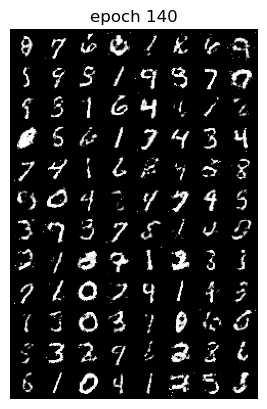

Epoch 140 of 150
Generator loss: 0.00307530, Discriminator loss: 0.00201638


235it [00:10, 21.65it/s]                         


Epoch 141 of 150
Generator loss: 0.00320911, Discriminator loss: 0.00239466


235it [00:10, 21.72it/s]                         


Epoch 142 of 150
Generator loss: 0.00341023, Discriminator loss: 0.00215580


235it [00:10, 21.71it/s]                         


Epoch 143 of 150
Generator loss: 0.00279739, Discriminator loss: 0.00204025


235it [00:10, 21.68it/s]                         


Epoch 144 of 150
Generator loss: 0.00260296, Discriminator loss: 0.00223768


235it [00:10, 21.83it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


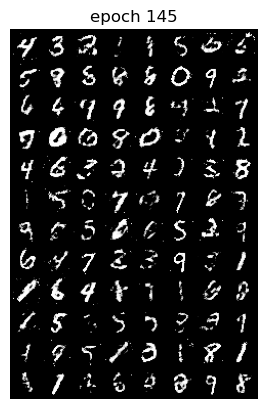

Epoch 145 of 150
Generator loss: 0.00254913, Discriminator loss: 0.00213810


235it [00:10, 21.87it/s]                         


Epoch 146 of 150
Generator loss: 0.00251658, Discriminator loss: 0.00236886


235it [00:10, 21.82it/s]                         


Epoch 147 of 150
Generator loss: 0.00212931, Discriminator loss: 0.00234755


235it [00:10, 21.80it/s]                         


Epoch 148 of 150
Generator loss: 0.00246125, Discriminator loss: 0.00214368


235it [00:10, 21.75it/s]                         


Epoch 149 of 150
Generator loss: 0.00280403, Discriminator loss: 0.00213606


235it [00:10, 21.79it/s]                         
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


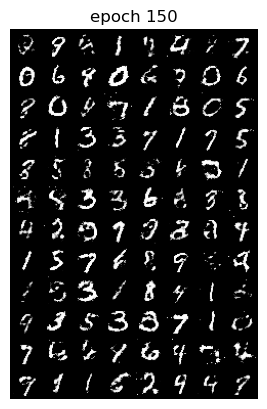

Epoch 150 of 150
Generator loss: 0.00244814, Discriminator loss: 0.00232797


In [118]:
torch.manual_seed(7777)
!mkdir outputs_d
def generator_loss(output, true_label):
    ############ YOUR CODE HERE ##########
    return criterion(output, true_label)
    
    
    ######################################
    
def discriminator_loss(output, true_label):
    ############ YOUR CODE HERE ##########
    return criterion(output, true_label)
    
    
    ######################################
    
losses_g = [] # to store generator loss after each epoch
losses_d = [] # to store discriminator loss after each epoch
images = [] # to store images generatd by the generator
epochs = 150
for epoch in range(epochs):
    loss_g = 0.0
    loss_d = 0.0
    for bi, data in tqdm(enumerate(train_loader), total=int(len(train_data)/train_loader.batch_size)):
        ############ YOUR CODE HERE ########## 
        real_images, _ = data
        real_images = real_images.to(device)
        batch_size = real_images.size(0)
        noise = create_noise(batch_size, nz)
        fake_sample = generator(noise)
        disc_r_samp = discriminator(real_images).view(-1)
        lossD_realSample = criterion(disc_r_samp, label_real(batch_size))
        disc_f_samp = discriminator(fake_sample).view(-1)
        lossD_fakeSample = criterion(disc_f_samp, label_fake(batch_size)) 
        loss_d = (0.7*lossD_realSample + 0.3*lossD_fakeSample)
        discriminator.zero_grad()
        loss_d.backward(retain_graph=True)
        optim_d.step()
        
        lossD_fakeSample = discriminator(fake_sample).view(-1)
        loss_g = criterion(lossD_fakeSample, label_real(batch_size))        
        generator.zero_grad()
        loss_g.backward()
        optim_g.step()
        
        ######################################
    
    
    # create the final fake image for the epoch
    generated_img = generator(noise).cpu().detach()
    
    # make the images as grid
    generated_img = make_grid(generated_img)
    
    # visualize generated images
    if (epoch + 1) % 5 == 0:
        plt.imshow(generated_img.permute(1, 2, 0))
        plt.title(f'epoch {epoch+1}')
        plt.axis('off')
        plt.show()
    
    # save the generated torch tensor models to disk
    save_generator_image(generated_img, f"outputs_d/gen_img{epoch+1}.png")
    images.append(generated_img)
    epoch_loss_g = loss_g / bi # total generator loss for the epoch
    epoch_loss_d = loss_d / bi # total discriminator loss for the epoch
    losses_g.append(epoch_loss_g)
    losses_d.append(epoch_loss_d)
    
    print(f"Epoch {epoch+1} of {epochs}")
    print(f"Generator loss: {epoch_loss_g:.8f}, Discriminator loss: {epoch_loss_d:.8f}")

In [119]:
print('DONE TRAINING')
torch.save(generator.state_dict(), 'outputs_d/generator.pth')

DONE TRAINING


In [120]:
# save the generated images as GIF file
imgs = [np.array(to_pil_image(img)) for img in images]
imageio.mimsave('outputs_d/generator_images.gif', imgs)

In [122]:
losses_g_up = [a.cpu().detach().numpy() if a!=0 else a for a in losses_g]
losses_d_up = [a.cpu().detach().numpy() if a!=0 else a for a in losses_d]

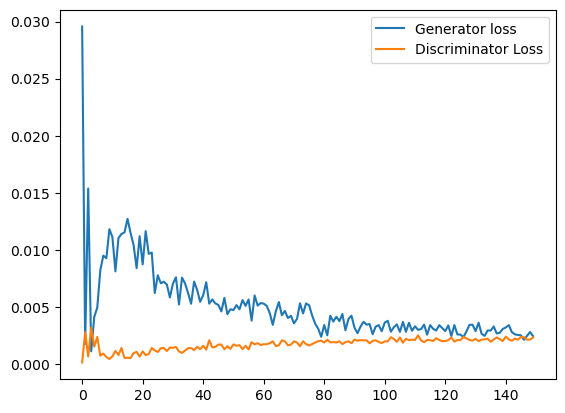

In [123]:
# plot and save the generator and discriminator loss
plt.figure()
plt.plot(losses_g_up, label='Generator loss')
plt.plot(losses_d_up, label='Discriminator Loss')
plt.legend()
plt.savefig('outputs_d/loss.png')